### Problem - 1
Context

The comp-activ database comprises activity measures of computer systems. Data was gathered from a Sun Sparcstation 20/712 with 128 Mbytes of memory, operating in a multi-user university department. Users engaged in diverse tasks, such as internet access, file editing, and CPU-intensive programs.

Being an aspiring data scientist, you aim to establish a linear equation for predicting 'usr' (the percentage of time CPUs operate in user mode). Your goal is to analyze various system attributes to understand their influence on the system's 'usr' mode.

### Data Description :

System measures used:

lread - Reads (transfers per second ) between system memory and user memory

lwrite - writes (transfers per second) between system memory and user memory

scall - Number of system calls of all types per second

sread - Number of system read calls per second .

swrite - Number of system write calls per second .

fork - Number of system fork calls per second.

exec - Number of system exec calls per second.

rchar - Number of characters transferred per second by system read calls

wchar - Number of characters transfreed per second by system write calls

pgout - Number of page out requests per second

ppgout - Number of pages, paged out per second

pgfree - Number of pages per second placed on the free list.

pgscan - Number of pages checked if they can be freed per second

atch - Number of page attaches (satisfying a page fault by reclaiming a page in memory) per second

pgin - Number of page-in requests per second

ppgin - Number of pages paged in per second

pflt - Number of page faults caused by protection errors (copy-on-writes).

vflt - Number of page faults caused by address translation .

runqsz - Process run queue size (The number of kernel threads in memory that are waiting for a CPU to run.

Typically, this value should be less than 2. Consistently higher values mean that the system might be CPU-bound.)

freemem - Number of memory pages available to user processes

freeswap - Number of disk blocks available for page swapping.

usr - Portion of time (%) that cpus run in user mode

### Problem 1 - Define the problem and perform exploratory Data Analysis
- Problem definition - Check shape, Data types, statistical summary - Univariate analysis - Multivariate analysis - Use appropriate visualizations to identify the patterns and insights - Key meaningful observations on individual variables and the relationship between variables

### Importing libraries and overview of the dataset

In [1]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import scale
from sklearn.linear_model import LinearRegression
from sklearn import metrics,model_selection
from sklearn.metrics import mean_squared_error
from statsmodels.stats.outliers_influence import variance_inflation_factor
import math
from scipy import stats

### Load the dataset

In [2]:
os.getcwd()

'C:\\Users\\admin\\Documents\\DSBA\\Predictive Modeling\\Week 4'

In [3]:
os.chdir(r'C:\Users\admin\Documents\DSBA\Predictive Modeling\Project')

In [4]:
compactiv = pd.read_excel("compactiv.xlsx")
compactiv.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,NaN,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,NaN,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,NaN,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


In [5]:
compactiv.tail()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
8187,16,12,3009,360,244,1.6,5.81,405250.0,85282.0,8.02,...,55.11,0.6,35.87,47.90,139.28,270.74,CPU_Bound,387,986647,80
8188,4,0,1596,170,146,2.4,1.80,89489.0,41764.0,3.80,...,0.20,0.8,3.80,4.40,122.40,212.60,Not_CPU_Bound,263,1055742,90
8189,16,5,3116,289,190,0.6,0.60,325948.0,52640.0,0.40,...,0.00,0.4,28.40,45.20,60.20,219.80,Not_CPU_Bound,400,969106,87
8190,32,45,5180,254,179,1.2,1.20,62571.0,29505.0,1.40,...,18.04,0.4,23.05,24.25,93.19,202.81,CPU_Bound,141,1022458,83
8191,2,0,985,55,46,1.6,4.80,111111.0,22256.0,0.00,...,0.00,0.2,3.40,6.20,91.80,110.00,CPU_Bound,659,1756514,94


In [6]:
compactiv.shape

(8192, 22)

### Get the info data types column wise

In [7]:
compactiv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8088 non-null   float64
 8   wchar     8177 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6

### Observation:
There are a total of 8192 rows and 22 columns in the dataset. Out of 22, 13 are float 8 are integertype and 1 object type variable 

We have 8192 rows and 22 columns in our Data-set.


### Get the summary statistics of the dataset

In [8]:
compactiv.describe().T

,count,mean,std,min,25%,50%,75%,max
lread,8192.0,1.955969e+01,53.353799,0.0,2.0,7.0,20.000,1845.00
lwrite,8192.0,1.310620e+01,29.891726,0.0,0.0,1.0,10.000,575.00
scall,8192.0,2.306318e+03,1633.617322,109.0,1012.0,2051.5,3317.250,12493.00
sread,8192.0,2.104800e+02,198.980146,6.0,86.0,166.0,279.000,5318.00
swrite,8192.0,1.500582e+02,160.478980,7.0,63.0,117.0,185.000,5456.00
fork,8192.0,1.884554e+00,2.479493,0.0,0.4,0.8,2.200,20.12
exec,8192.0,2.791998e+00,5.212456,0.0,0.2,1.2,2.800,59.56
rchar,8088.0,1.973857e+05,239837.493526,278.0,34091.5,125473.5,267828.750,2526649.00
wchar,8177.0,9.590299e+04,140841.707911,1498.0,22916.0,46619.0,106101.000,1801623.00
pgout,8192.0,2.285317e+00,5.307038,0.0,0.0,0.0,2.400,81.44


### Univariate analysis for numerical data (Histplot & Boxplot):

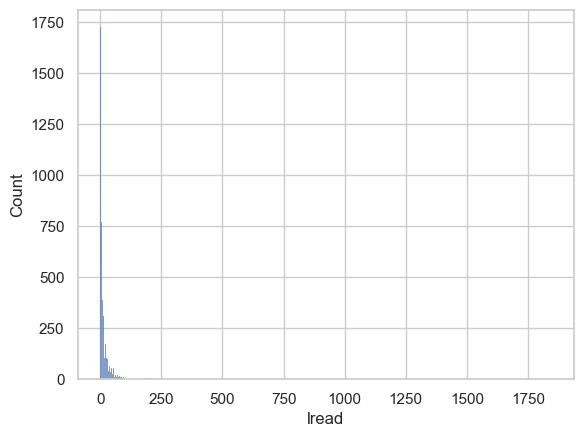

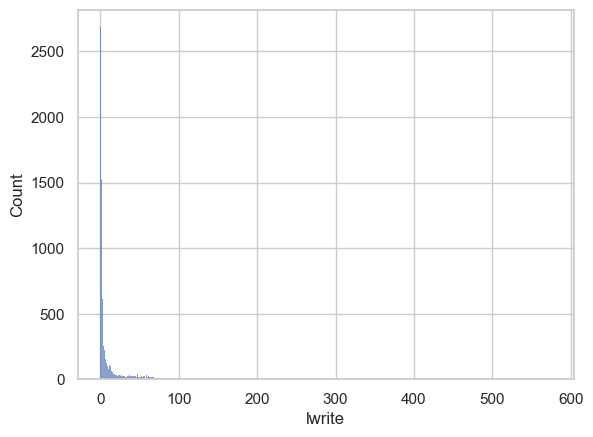

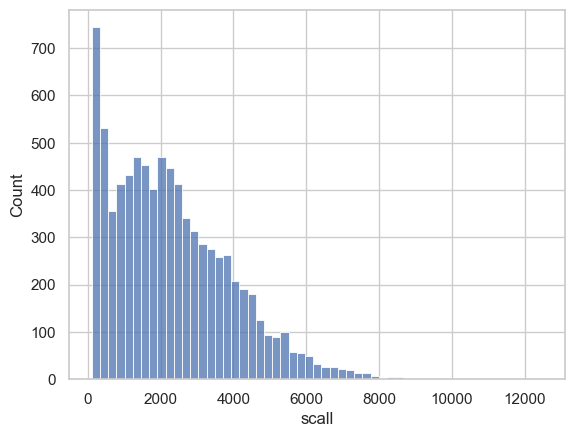

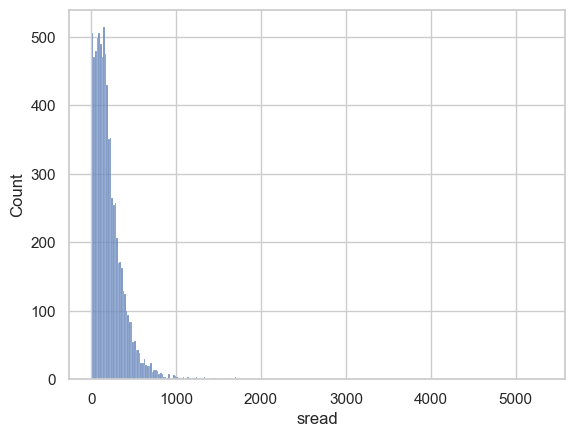

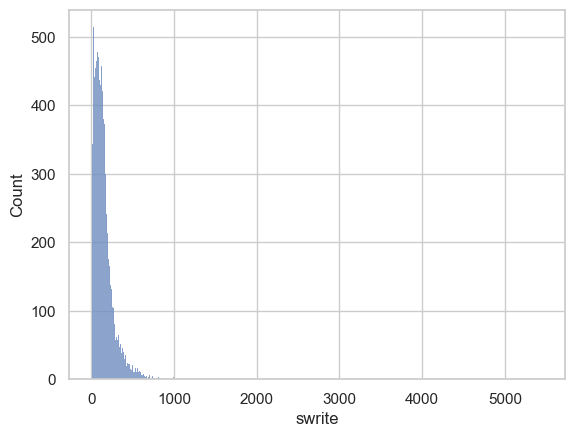

...

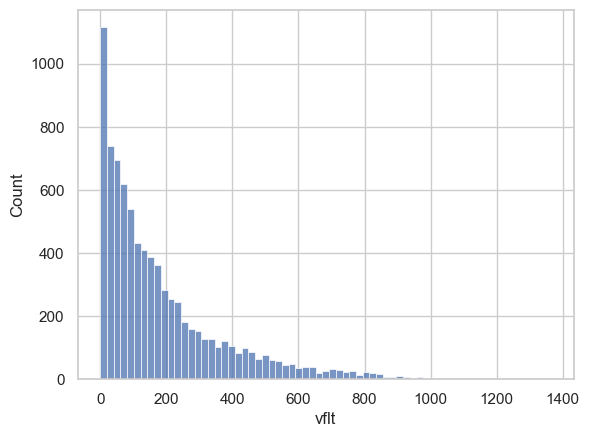

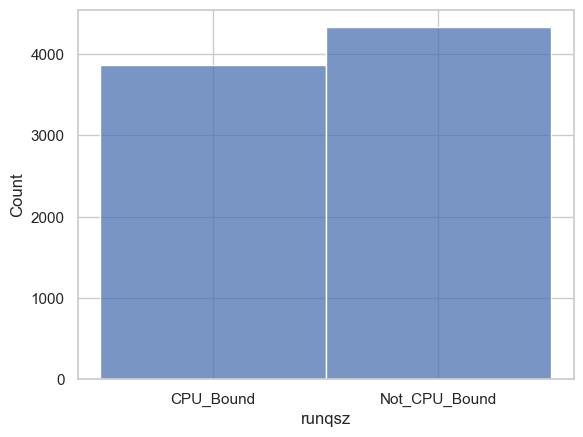

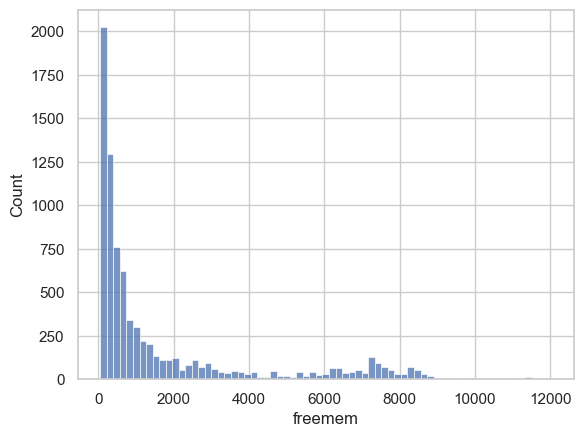

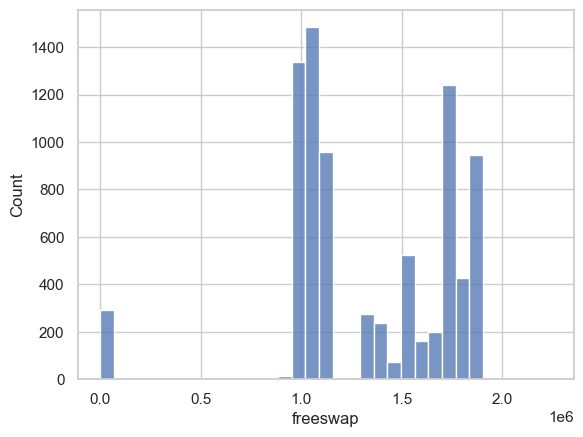

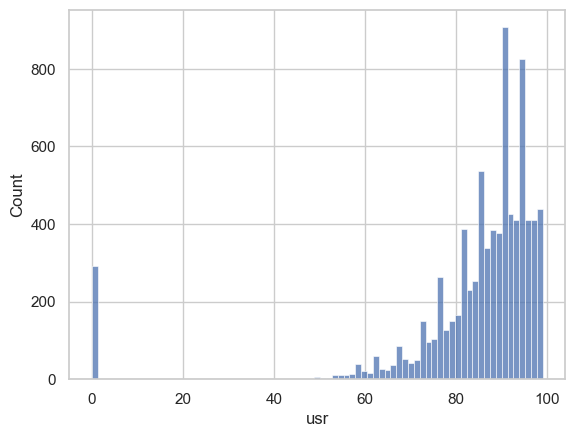

In [55]:
#Histplots 

for col in compactiv.columns:
    sns.histplot(x=compactiv[col])
    plt.show()

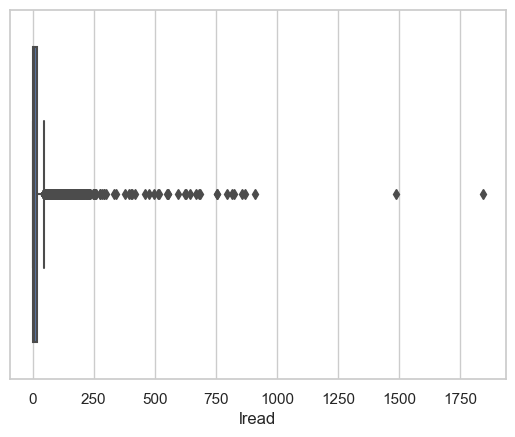

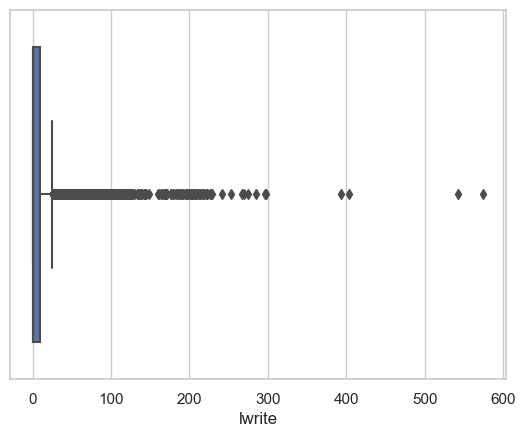

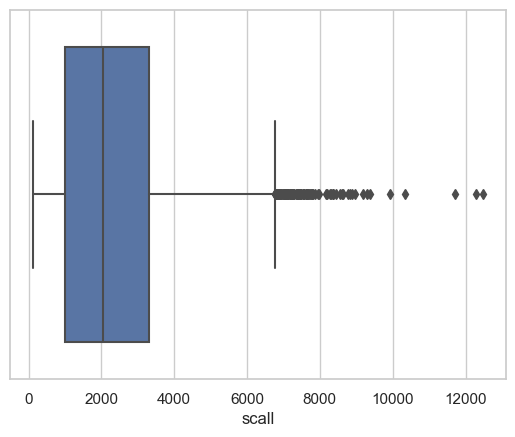

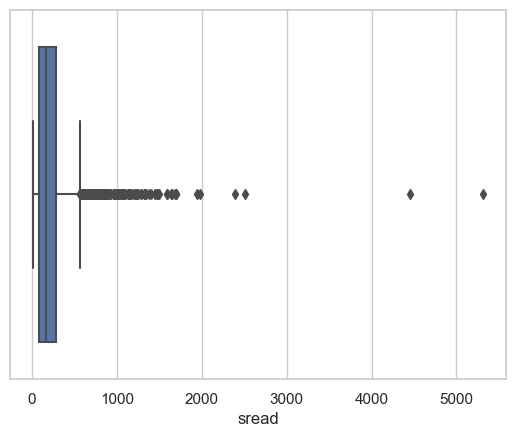

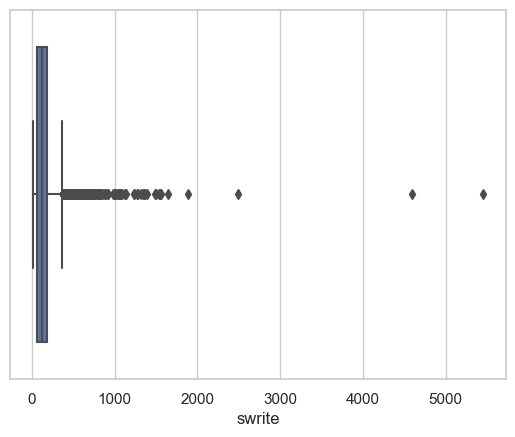

...

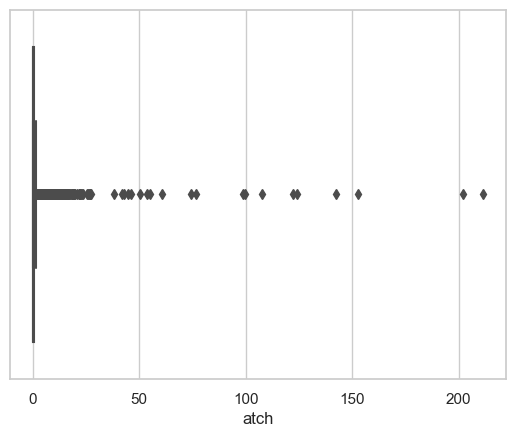

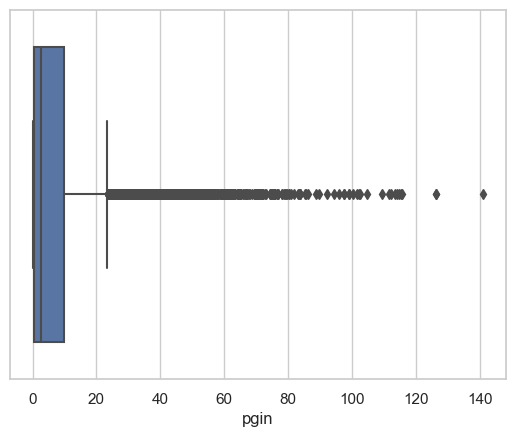

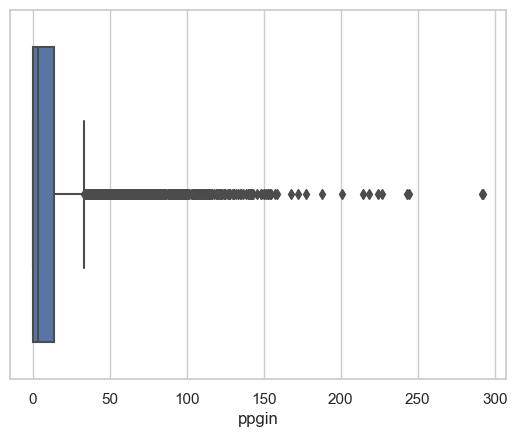

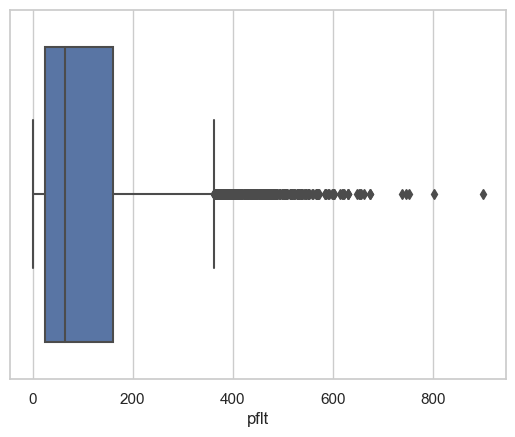

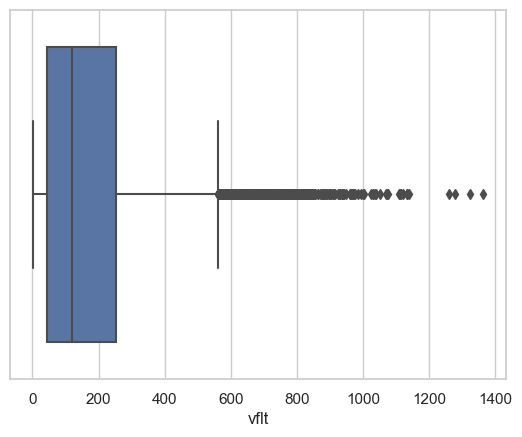

TypeError: Horizontal orientation requires numeric `x` variable.

In [233]:
#Boxlots 

for col in compactiv.columns:
    sns.boxplot(x=compactiv[col])
    plt.show()

### Observations:

We have outliers for our columns, we need to treat those before further analysis, from the Histplot wecan say all the features are having left-skewed distribution. ‘usr’ feature is having right skeweddistribution.

#### Univariate analysis for categorical data

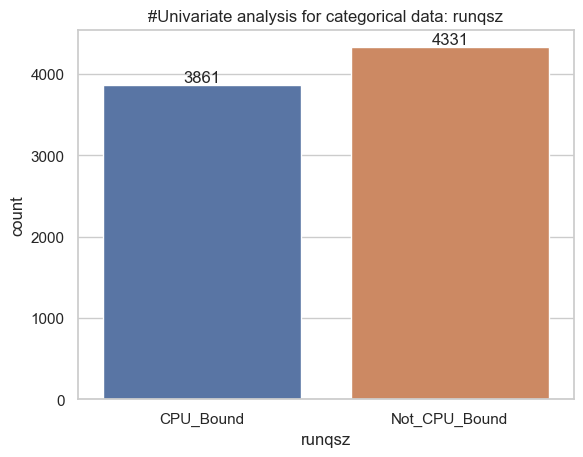

In [234]:
cc=sns.countplot(data=compactiv,x='runqsz')
plt.bar_label(cc.containers[0])
plt.title('#Univariate analysis for categorical data: runqsz');

### observations:

From the analysis we can say we have total ‘Process run queue size’3861 as CPU_Bound and 4331 asNot_ CPU_Bound.

### #Bivariate analysis: Pairplot (pairwise relationships between variables):

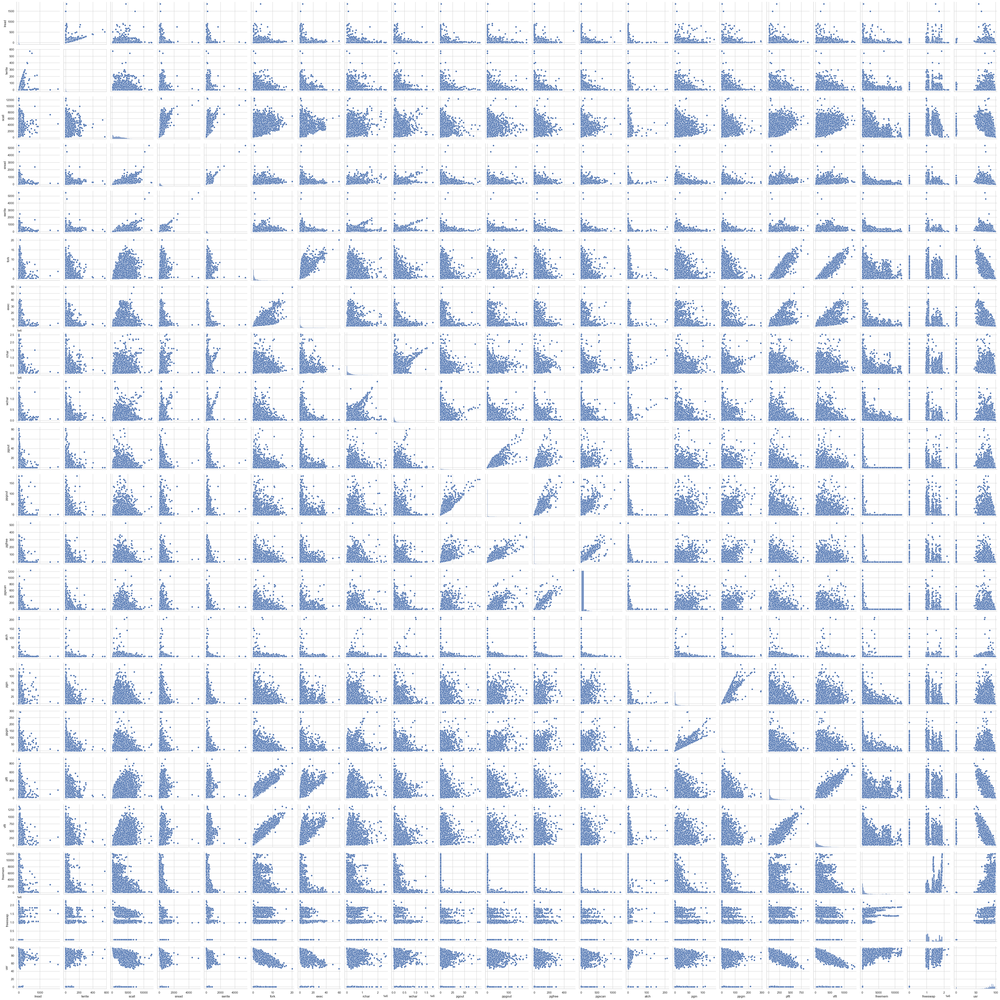

In [59]:
sns.pairplot(compactiv)

### #Bivariate analysis: Heatmap (Check for presence of correlations):

C:\Users\admin\AppData\Local\Temp\ipykernel_2060\2676323425.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(compactiv.corr(), annot=True,fmt='.2f');


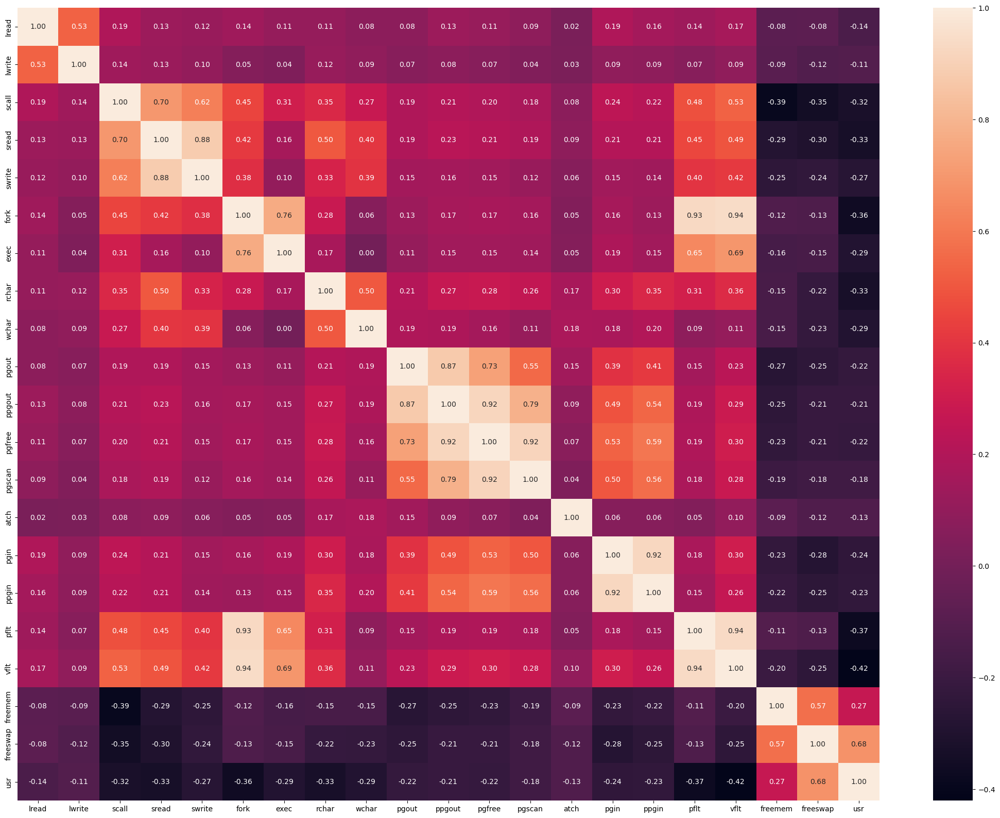

In [25]:
#Check for presence of correlations
plt.figure(figsize = (27,20))
sns.heatmap(compactiv.corr(), annot=True,fmt='.2f');

### Observations: 

From the analysis we can see the presence of correlations.

### Problem 1 - Data Pre-processing
Prepare the data for modelling: - Missing Value Treatment (if needed) - Outlier Detection (treat, if needed) - Feature Engineering - Encode the data - Train-test split

In [9]:
# Are there any missing values ?
compactiv.isnull().sum()

lread         0
lwrite        0
scall         0
sread         0
swrite        0
fork          0
exec          0
rchar       104
wchar        15
pgout         0
ppgout        0
pgfree        0
pgscan        0
atch          0
pgin          0
ppgin         0
pflt          0
vflt          0
runqsz        0
freemem       0
freeswap      0
usr           0
dtype: int64

We can see we have null values for ‘rchar’ and ‘wchar’, As it is a continuous variable, mean value can beimputed.

### Imputing missing values


In [10]:
cols = ['rchar','wchar']
for column in cols:
    print(column)
    mean_1 = compactiv[column].mean()
    print(mean_1)
    compactiv[column].fillna(value=mean_1,inplace=True)
    
compactiv.isnull().sum() 

rchar
197385.72836300693
wchar
95902.99278463985


lread       0
lwrite      0
scall       0
sread       0
swrite      0
fork        0
exec        0
rchar       0
wchar       0
pgout       0
ppgout      0
pgfree      0
pgscan      0
atch        0
pgin        0
ppgin       0
pflt        0
vflt        0
runqsz      0
freemem     0
freeswap    0
usr         0
dtype: int64

In [11]:
# Check for duplicate data

dups = compactiv.duplicated()
print('Number of duplicate rows = %d' % (dups.sum()))

compactiv[dups]

Number of duplicate rows = 0


,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr


### Unique values for categorical variables

In [12]:
compactiv['runqsz'].value_counts()

Not_CPU_Bound    4331
CPU_Bound        3861
Name: runqsz, dtype: int64

In [13]:
compactiv.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.000000,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.000000,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,197385.728363,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,197385.728363,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,197385.728363,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


### Converting categorical to dummy variables

In [14]:
df = pd.DataFrame(compactiv)

# Convert categorical variables to dummy variables
df_dummies = pd.get_dummies(df, columns=['runqsz'], drop_first=True)

# Display the updated DataFrame with dummy variables
print("DataFrame after converting categorical to dummy variables:")
print(df_dummies)

DataFrame after converting categorical to dummy variables:
      lread  lwrite  scall  sread  swrite  fork  exec          rchar    wchar  \
0         1       0   2147     79      68   0.2  0.20   40671.000000  53995.0   
1         0       0    170     18      21   0.2  0.20     448.000000   8385.0   
2        15       3   2162    159     119   2.0  2.40  197385.728363  31950.0   
3         0       0    160     12      16   0.2  0.20  197385.728363   8670.0   
4         5       1    330     39      38   0.4  0.40  197385.728363  12185.0   
...     ...     ...    ...    ...     ...   ...   ...            ...      ...   
8187     16      12   3009    360     244   1.6  5.81  405250.000000  85282.0   
8188      4       0   1596    170     146   2.4  1.80   89489.000000  41764.0   
8189     16       5   3116    289     190   0.6  0.60  325948.000000  52640.0   
8190     32      45   5180    254     179   1.2  1.20   62571.000000  29505.0   
8191      2       0    985     55      46   1.6  4

In [15]:
df_dummies

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,1,0,2147,79,68,0.2,0.20,40671.000000,53995.0,0.00,...,0.00,0.0,1.60,2.60,16.00,26.40,4670,1730946,95,0
1,0,0,170,18,21,0.2,0.20,448.000000,8385.0,0.00,...,0.00,0.0,0.00,0.00,15.63,16.83,7278,1869002,97,1
2,15,3,2162,159,119,2.0,2.40,197385.728363,31950.0,0.00,...,0.00,1.2,6.00,9.40,150.20,220.20,702,1021237,87,1
3,0,0,160,12,16,0.2,0.20,197385.728363,8670.0,0.00,...,0.00,0.0,0.20,0.20,15.60,16.80,7248,1863704,98,1
4,5,1,330,39,38,0.4,0.40,197385.728363,12185.0,0.00,...,0.00,0.0,1.00,1.20,37.80,47.60,633,1760253,90,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8187,16,12,3009,360,244,1.6,5.81,405250.000000,85282.0,8.02,...,55.11,0.6,35.87,47.90,139.28,270.74,387,986647,80,0
8188,4,0,1596,170,146,2.4,1.80,89489.000000,41764.0,3.80,...,0.20,0.8,3.80,4.40,122.40,212.60,263,1055742,90,1
8189,16,5,3116,289,190,0.6,0.60,325948.000000,52640.0,0.40,...,0.00,0.4,28.40,45.20,60.20,219.80,400,969106,87,1
8190,32,45,5180,254,179,1.2,1.20,62571.000000,29505.0,1.40,...,18.04,0.4,23.05,24.25,93.19,202.81,141,1022458,83,0


### treating Nan Values in the dataset for each column

In [16]:
compactiv = pd.DataFrame(df_dummies)

# Replace NaN values with the mean of each column
compactiv_filled = compactiv.apply(lambda col: col.fillna(col.mean()))

# Display the updated DataFrame
print("Updated DataFrame after replacing NaN values:")
print(compactiv_filled)

Updated DataFrame after replacing NaN values:
      lread  lwrite  scall  sread  swrite  fork  exec          rchar    wchar  \
0         1       0   2147     79      68   0.2  0.20   40671.000000  53995.0   
1         0       0    170     18      21   0.2  0.20     448.000000   8385.0   
2        15       3   2162    159     119   2.0  2.40  197385.728363  31950.0   
3         0       0    160     12      16   0.2  0.20  197385.728363   8670.0   
4         5       1    330     39      38   0.4  0.40  197385.728363  12185.0   
...     ...     ...    ...    ...     ...   ...   ...            ...      ...   
8187     16      12   3009    360     244   1.6  5.81  405250.000000  85282.0   
8188      4       0   1596    170     146   2.4  1.80   89489.000000  41764.0   
8189     16       5   3116    289     190   0.6  0.60  325948.000000  52640.0   
8190     32      45   5180    254     179   1.2  1.20   62571.000000  29505.0   
8191      2       0    985     55      46   1.6  4.80  111111.0

In [17]:
compactiv_filled

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,1,0,2147,79,68,0.2,0.20,40671.000000,53995.0,0.00,...,0.00,0.0,1.60,2.60,16.00,26.40,4670,1730946,95,0
1,0,0,170,18,21,0.2,0.20,448.000000,8385.0,0.00,...,0.00,0.0,0.00,0.00,15.63,16.83,7278,1869002,97,1
2,15,3,2162,159,119,2.0,2.40,197385.728363,31950.0,0.00,...,0.00,1.2,6.00,9.40,150.20,220.20,702,1021237,87,1
3,0,0,160,12,16,0.2,0.20,197385.728363,8670.0,0.00,...,0.00,0.0,0.20,0.20,15.60,16.80,7248,1863704,98,1
4,5,1,330,39,38,0.4,0.40,197385.728363,12185.0,0.00,...,0.00,0.0,1.00,1.20,37.80,47.60,633,1760253,90,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8187,16,12,3009,360,244,1.6,5.81,405250.000000,85282.0,8.02,...,55.11,0.6,35.87,47.90,139.28,270.74,387,986647,80,0
8188,4,0,1596,170,146,2.4,1.80,89489.000000,41764.0,3.80,...,0.20,0.8,3.80,4.40,122.40,212.60,263,1055742,90,1
8189,16,5,3116,289,190,0.6,0.60,325948.000000,52640.0,0.40,...,0.00,0.4,28.40,45.20,60.20,219.80,400,969106,87,1
8190,32,45,5180,254,179,1.2,1.20,62571.000000,29505.0,1.40,...,18.04,0.4,23.05,24.25,93.19,202.81,141,1022458,83,0


In [18]:
compactiv_filled.head(10)

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,1,0,2147,79,68,0.2,0.2,40671.000000,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,4670,1730946,95,0
1,0,0,170,18,21,0.2,0.2,448.000000,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,7278,1869002,97,1
2,15,3,2162,159,119,2.0,2.4,197385.728363,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,702,1021237,87,1
3,0,0,160,12,16,0.2,0.2,197385.728363,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,7248,1863704,98,1
4,5,1,330,39,38,0.4,0.4,197385.728363,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,633,1760253,90,1
5,0,0,1201,65,61,0.4,0.4,197385.728363,58703.0,0.0,...,0.0,0.0,0.0,0.0,28.40,34.40,6854,1877461,96,1
6,1,0,5744,168,190,0.2,0.2,197385.728363,189975.0,6.0,...,0.0,4.4,0.6,0.6,27.40,28.60,312,1013458,89,1
7,21,18,2799,291,211,0.6,0.4,197385.728363,259868.0,2.6,...,0.0,0.0,1.0,1.0,35.40,71.00,87,13,0,0
8,0,0,264,42,33,0.2,0.2,197385.728363,10116.0,0.0,...,0.0,0.0,0.4,0.8,15.63,18.44,1374,1749756,98,1
9,0,0,188,13,24,0.2,0.2,197385.728363,6777.0,0.0,...,0.0,0.0,0.0,0.0,15.60,16.80,5310,1859912,98,1


In [19]:
compactiv_filled.tail(10)

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
8182,10,0,5975,692,612,2.20,2.00,505718.0,475455.0,5.99,...,122.55,0.40,24.15,72.85,95.21,230.54,126,1039337,77,1
8183,4,3,1509,501,139,0.60,1.00,312242.0,255308.0,0.00,...,0.00,0.00,3.20,3.20,52.60,119.60,1051,1600333,92,0
8184,8,2,4784,416,240,1.20,1.60,442876.0,110453.0,7.82,...,129.06,0.40,35.27,48.70,106.81,329.86,205,1011407,77,0
8185,13,0,4279,235,176,12.22,34.47,289309.0,30701.0,0.40,...,7.01,8.82,4.21,4.21,397.60,751.30,184,1079269,61,1
8186,0,0,300,56,46,0.20,0.20,1995.0,18052.0,0.80,...,0.00,0.00,0.00,0.00,21.00,18.00,272,1754832,97,1
8187,16,12,3009,360,244,1.60,5.81,405250.0,85282.0,8.02,...,55.11,0.60,35.87,47.90,139.28,270.74,387,986647,80,0
8188,4,0,1596,170,146,2.40,1.80,89489.0,41764.0,3.80,...,0.20,0.80,3.80,4.40,122.40,212.60,263,1055742,90,1
8189,16,5,3116,289,190,0.60,0.60,325948.0,52640.0,0.40,...,0.00,0.40,28.40,45.20,60.20,219.80,400,969106,87,1
8190,32,45,5180,254,179,1.20,1.20,62571.0,29505.0,1.40,...,18.04,0.40,23.05,24.25,93.19,202.81,141,1022458,83,0
8191,2,0,985,55,46,1.60,4.80,111111.0,22256.0,0.00,...,0.00,0.20,3.40,6.20,91.80,110.00,659,1756514,94,0


In [20]:
compactiv_filled.dtypes

lread                     int64
lwrite                    int64
scall                     int64
sread                     int64
swrite                    int64
fork                    float64
exec                    float64
rchar                   float64
wchar                   float64
pgout                   float64
ppgout                  float64
pgfree                  float64
pgscan                  float64
atch                    float64
pgin                    float64
ppgin                   float64
pflt                    float64
vflt                    float64
freemem                   int64
freeswap                  int64
usr                       int64
runqsz_Not_CPU_Bound      uint8
dtype: object

### Outlier Checks

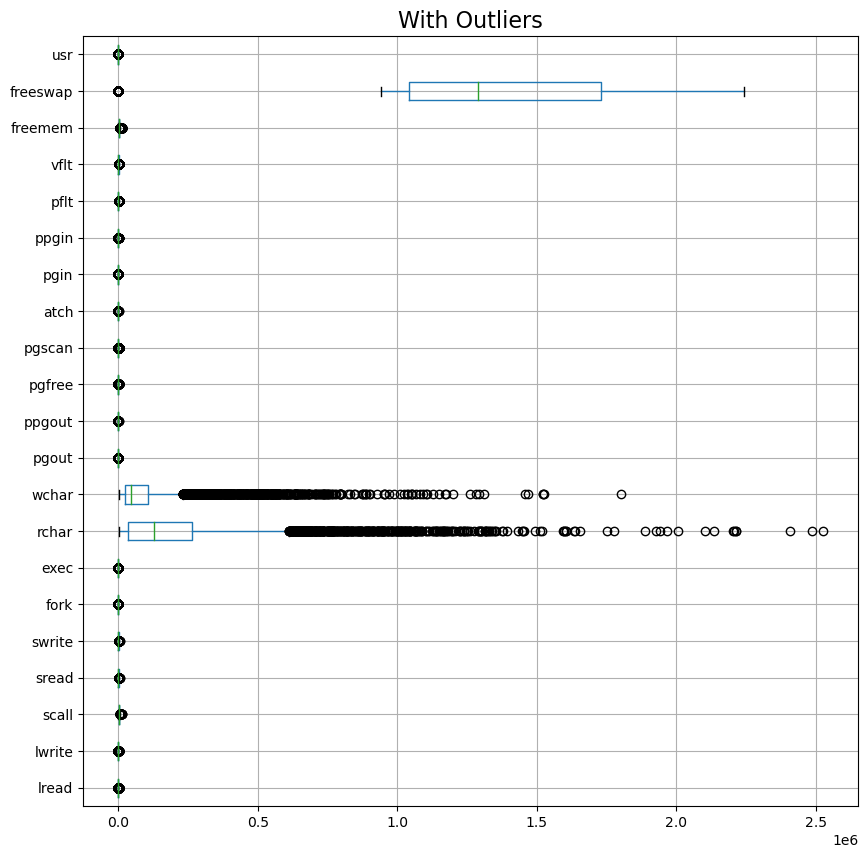

In [21]:
# construct box plot for continuous variables
cont=compactiv_filled.dtypes[(compactiv_filled.dtypes!='uint8') & (compactiv_filled.dtypes!='bool')].index
plt.figure(figsize=(10,10))
df[cont].boxplot(vert=0)
plt.title('With Outliers',fontsize=16)
plt.show()

In [22]:
def remove_outlier(col):
    sorted(col)
    Q1,Q3=np.percentile(col,[25,75])
    IQR=Q3-Q1
    lower_range= Q1-(1.5 * IQR)
    upper_range= Q3+(1.5 * IQR)
    return lower_range, upper_range

In [23]:
for column in compactiv_filled[cont].columns:
    lr,ur=remove_outlier(compactiv_filled[column])
    compactiv_filled[column]=np.where(compactiv_filled[column]>ur,ur,compactiv_filled[column])
    compactiv_filled[column]=np.where(compactiv_filled[column]<lr,lr,compactiv_filled[column])

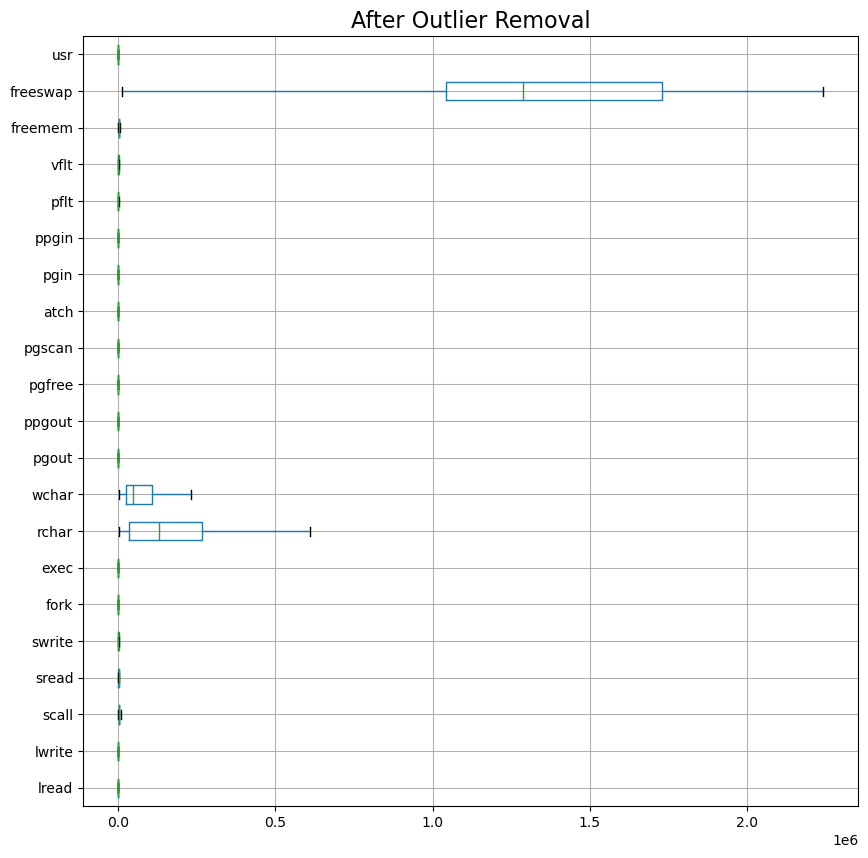

In [24]:
plt.figure(figsize=(10,10))
compactiv_filled[cont].boxplot(vert=0)
plt.title('After Outlier Removal',fontsize=16)
plt.show()

### outlier Treatment

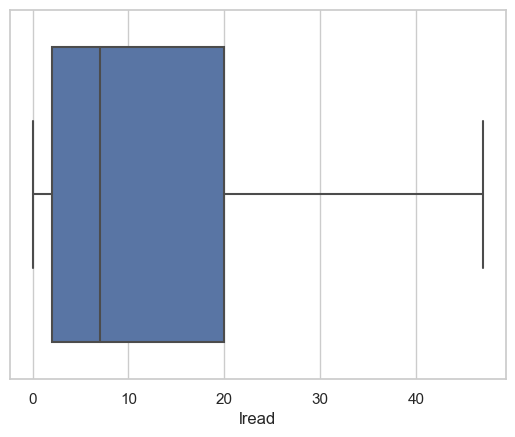

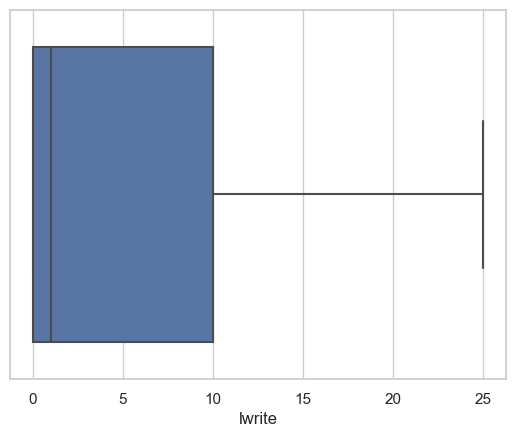

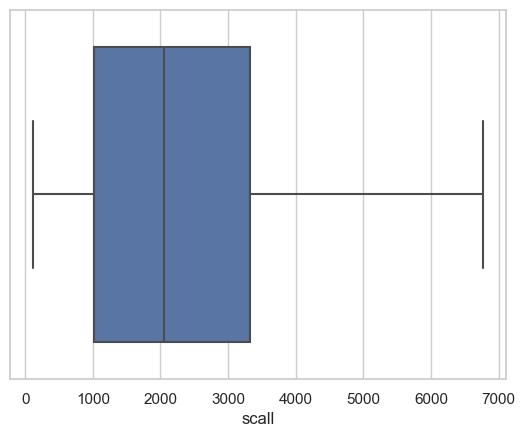

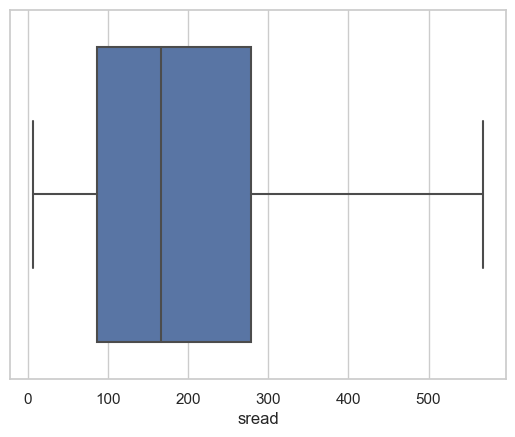

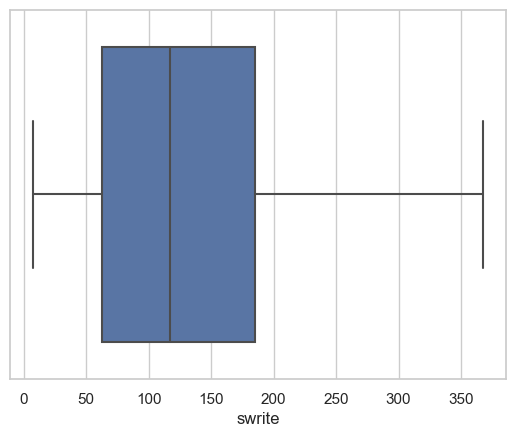

...

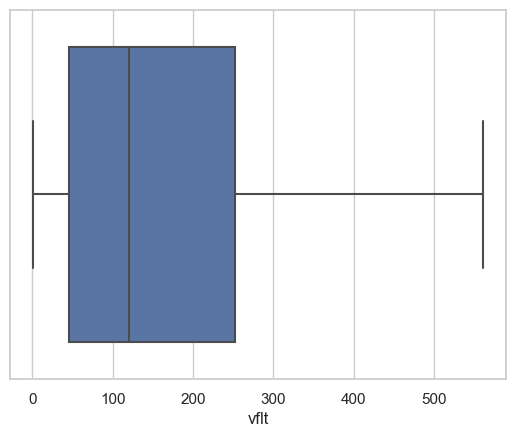

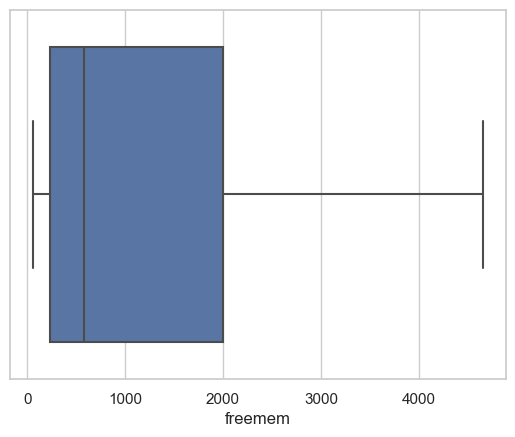

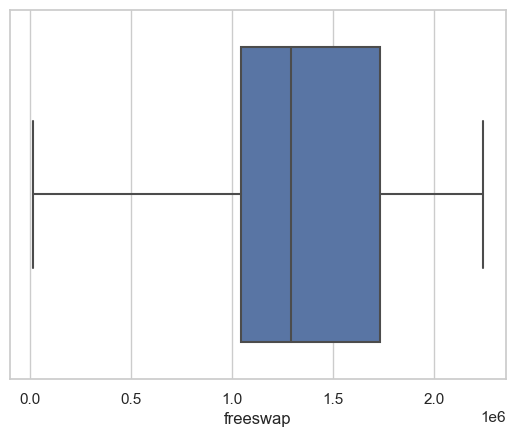

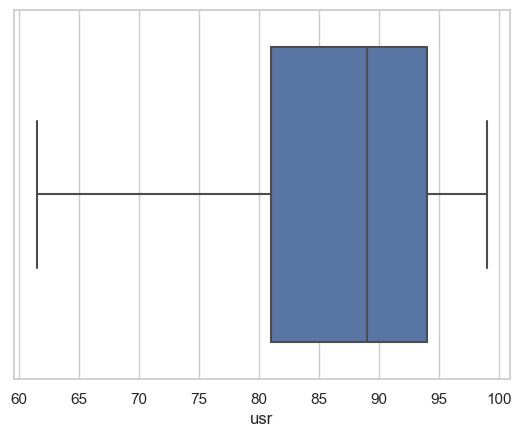

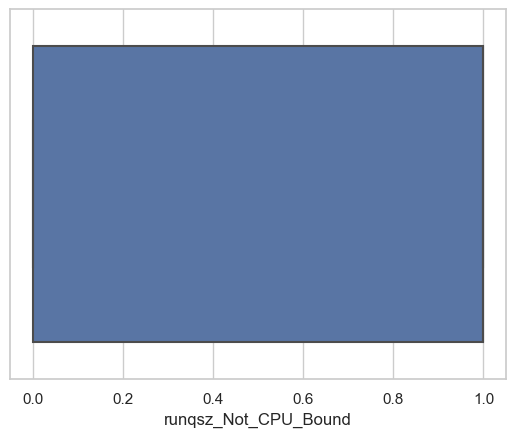

In [251]:
#Boxlots 

for col in compactiv_filled.columns:
    sns.boxplot(x=compactiv_filled[col])
    plt.show()

### Data Distribution


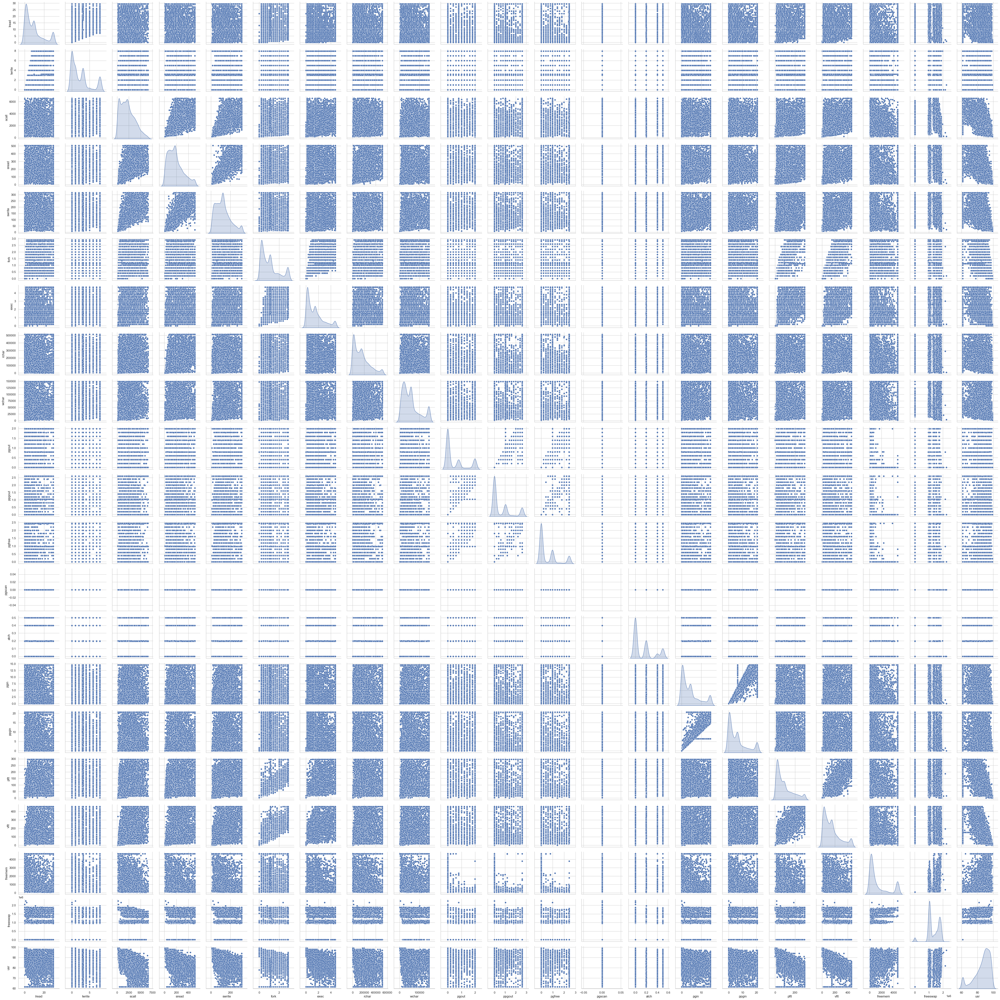

In [111]:
compactiv_filled_attr = (compactiv_filled[cont])
sns.pairplot(compactiv_filled_attr, diag_kind='kde')  
plt.show()

### Train-Test Split


In [25]:
# Copy all the predictor variables into X dataframe
X = compactiv_filled.drop('usr', axis=1)

# Copy target into the y dataframe. 
y = compactiv_filled[['usr']]

In [26]:
X.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,pgscan,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,runqsz_Not_CPU_Bound
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.2,40671.000000,53995.0,0.0,...,0.0,0.0,0.0,1.6,2.6,16.00,26.40,4659.125,1730946.0,0
1,0.0,0.0,170.0,18.0,21.0,0.2,0.2,448.000000,8385.0,0.0,...,0.0,0.0,0.0,0.0,0.0,15.63,16.83,4659.125,1869002.0,1
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.4,197385.728363,31950.0,0.0,...,0.0,0.0,1.2,6.0,9.4,150.20,220.20,702.000,1021237.0,1
3,0.0,0.0,160.0,12.0,16.0,0.2,0.2,197385.728363,8670.0,0.0,...,0.0,0.0,0.0,0.2,0.2,15.60,16.80,4659.125,1863704.0,1
4,5.0,1.0,330.0,39.0,38.0,0.4,0.4,197385.728363,12185.0,0.0,...,0.0,0.0,0.0,1.0,1.2,37.80,47.60,633.000,1760253.0,1


In [27]:
y.head()

,usr
0,95.0
1,97.0
2,87.0
3,98.0
4,90.0


In [28]:
# Split X and y into training and test set in 75:25 ratio
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25 , random_state=1)

### Problem 1- Model Building - Linear regression
- Apply linear Regression using Sklearn - Using Statsmodels Perform checks for significant variables using the appropriate method - Create multiple models and check the performance of Predictions on Train and Test sets using Rsquare, RMSE & Adj Rsquare.

We have already encoded the object data to categorical variable

### Linear Regression using statsmodel(OLS)

In [29]:
import statsmodels.api as sm

In [30]:
X_train=sm.add_constant(X_train)# This adds the constant term beta0 to the Simple Linear Regression.
X_test=sm.add_constant(X_test)

In [31]:
model = sm.OLS(y_train,X_train).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    usr   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.794
Method:                 Least Squares   F-statistic:                     1183.
Date:                Sun, 17 Dec 2023   Prob (F-statistic):               0.00
Time:                        14:43:03   Log-Likelihood:                -17869.
No. Observations:                6144   AIC:                         3.578e+04
Df Residuals:                    6123   BIC:                         3.592e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   84.0346 

### Checking Multicollinearity using Variance Inflation Factor (VIF)


In [32]:
# let's check the VIF of the predictors
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("VIF values: \n\n{}\n".format(vif_series1))

VIF values: 

const                   28.922509
lread                    5.329591
lwrite                   4.320862
scall                    2.960752
sread                    6.409323
swrite                   5.595076
fork                    13.006965
exec                     3.200037
rchar                    2.118063
wchar                    1.594694
pgout                   11.240263
ppgout                  29.300121
pgfree                  16.538930
pgscan                        NaN
atch                     1.873710
pgin                    13.824371
ppgin                   13.986611
pflt                    11.958441
vflt                    15.570790
freemem                  1.958337
freeswap                 1.837574
runqsz_Not_CPU_Bound     1.156772
dtype: float64



C:\Users\admin\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1781: RuntimeWarning: invalid value encountered in scalar divide
  return 1 - self.ssr/self.centered_tss


Variance Inflation Factor (VIF) is one of the methods to check if independent variables have correlation between them. If they are correlated, then it is not ideal for linear regression models as they inflate the standard errors which in turn affects the regression parameters. As a result, the regression model becomes non-reliable and lacks interpretability.

General rule of thumb: If VIF values are equal to 1, then that means there is no multicollinearity. If VIF values are equal to 5 or exceedingly more than 5, then there is moderate multicollinearity. If VIF is 10 or more, then that means there is high collinearity

From the above I can conclude that variables have strong correlation

AS all predictors have VIF values >5 & >10 therefore there is multicolinearity in the data

We remove those predictors with multicolinarity due to which there is least impact on the adjusted R2

In [33]:
X_train.columns

Index(['const', 'lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec',
       'rchar', 'wchar', 'pgout', 'ppgout', 'pgfree', 'pgscan', 'atch', 'pgin',
       'ppgin', 'pflt', 'vflt', 'freemem', 'freeswap', 'runqsz_Not_CPU_Bound'],
      dtype='object')

In [34]:
X_test.columns

Index(['const', 'lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec',
       'rchar', 'wchar', 'pgout', 'ppgout', 'pgfree', 'pgscan', 'atch', 'pgin',
       'ppgin', 'pflt', 'vflt', 'freemem', 'freeswap', 'runqsz_Not_CPU_Bound'],
      dtype='object')

In [35]:
# Function to evaluate model performance
from sklearn.metrics import r2_score, mean_squared_error
def evaluate_model(model, X, y):
    y_pred = model.predict(X)
    r2 = r2_score(y, y_pred)
    rmse = mean_squared_error(y, y_pred, squared=False)
    
    X = sm.add_constant(X)  # Add a constant for the statsmodels model
    model_stats = sm.OLS(y, X).fit()
    adj_r2 = model_stats.rsquared_adj
    
    return r2, rmse, adj_r2

In [36]:
# Linear Regression Model
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

# Evaluate Linear Regression Model on Train Set
r2_train, rmse_train, adj_r2_train = evaluate_model(linear_model, X_train, y_train)
print("Linear Regression Model - Train Set:")
print(f"R-squared: {r2_train:.4f}")
print(f"RMSE: {rmse_train:.4f}")
print(f"Adjusted R-squared: {adj_r2_train:.4f}")

Linear Regression Model - Train Set:
R-squared: 0.7944
RMSE: 4.4347
Adjusted R-squared: 0.7938


In [37]:
# Evaluate Linear Regression Model on Test Set
r2_test, rmse_test, adj_r2_test = evaluate_model(linear_model, X_test, y_test)
print("\nLinear Regression Model - Test Set:")
print(f"R-squared: {r2_test:.4f}")
print(f"RMSE: {rmse_test:.4f}")
print(f"Adjusted R-squared: {adj_r2_test:.4f}")


Linear Regression Model - Test Set:
R-squared: 0.7677
RMSE: 4.6498
Adjusted R-squared: 0.7719


### Testing the Assumptions of Linear Regression


For Linear Regression, we need to check if the following assumptions hold:-

Linearity

Independence

Homoscedasticity

Normality of error terms

No strong Multicollinearity

### Linearity and Independence of predictors


In [38]:
df_pred = pd.DataFrame()

df_pred["Actual Values"] = y_train.values.flatten()  # actual values
df_pred["Fitted Values"] = model.fittedvalues.values  # predicted values
df_pred["Residuals"] = model.resid.values  # residuals

df_pred.head()

,Actual Values,Fitted Values,Residuals
0,94.0,89.748759,4.251241
1,96.0,88.175128,7.824872
2,77.0,77.515740,-0.515740
3,93.0,97.899207,-4.899207
4,86.0,86.279003,-0.279003


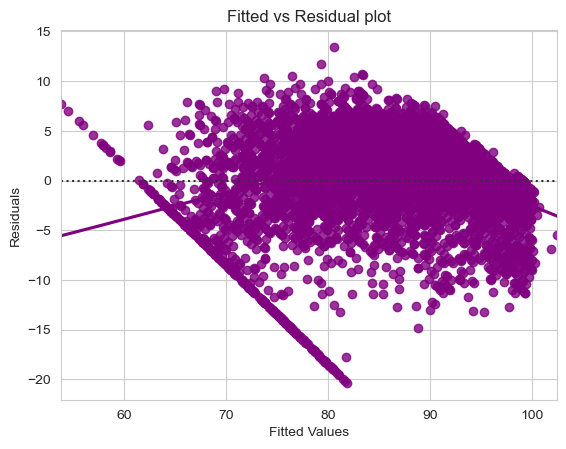

In [39]:
# let us plot the fitted values vs residuals
sns.set_style("whitegrid")
sns.residplot(
    data=df_pred, x="Fitted Values", y="Residuals", color="purple", lowess=True
)
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Fitted vs Residual plot")
plt.show()

No pattern in the data thus the assumption of linearity and independence of predictors satisfied

### Test for Normality


In [40]:
stats.shapiro(df_pred["Residuals"])

C:\Users\admin\anaconda3\Lib\site-packages\scipy\stats\_morestats.py:1816: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9396172165870667, pvalue=1.8216880036222622e-44)

Since p-value < 0.05, the residuals are not normal as per shapiro test.

### Test for Homoscedasticity


In [41]:
import statsmodels.stats.api as sms
sms.het_goldfeldquandt(df_pred["Residuals"], X_train)[1]

0.013149407723058715

Since p-value < 0.05 we can say that the residuals are not homoscedastic.

### Linear Regression using (sklearn)


In [42]:
# invoke the LinearRegression function and find the bestfit model on training data

regression_model = LinearRegression()
regression_model.fit(X_train, y_train)

LinearRegression()

In [43]:
# Let us explore the coefficients for each of the independent attributes

for idx, col_name in enumerate(X_train.columns):
    print("The coefficient for {} is {}".format(col_name, regression_model.coef_[0][idx]))

The coefficient for const is 0.0
The coefficient for lread is -0.06404648267995358
The coefficient for lwrite is 0.04813190228866851
The coefficient for scall is -0.0006774787094161596
The coefficient for sread is 0.0005735217626207104
The coefficient for swrite is -0.005612482396285557
The coefficient for fork is 0.035814742329562256
The coefficient for exec is -0.3046607987538527
The coefficient for rchar is -5.224927758583353e-06
The coefficient for wchar is -5.243424795045755e-06
The coefficient for pgout is -0.4191071513985912
The coefficient for ppgout is -0.025601910635729492
The coefficient for pgfree is 0.06300223587006978
The coefficient for pgscan is 6.661338147750939e-16
The coefficient for atch is 0.6566420315976981
The coefficient for pgin is 0.022841407008107422
The coefficient for ppgin is -0.0714684685995848
The coefficient for pflt is -0.03366381482259285
The coefficient for vflt is -0.0054299889745494274
The coefficient for freemem is -0.0004713902067933551
The coeff

In [44]:
# Let us check the intercept for the model

intercept = regression_model.intercept_[0]

print("The intercept for our model is {}".format(intercept))

The intercept for our model is 84.03456554949716


In [45]:
# R square on training data
regression_model.score(X_train, y_train)

0.7944387950168765

79% of the variation in the usr is explained by the predictors in the model for train set

In [46]:
# R square on testing data
regression_model.score(X_test, y_test)

0.767701459165733

The R-squared value tells us that our model can explain 76.7% of the variance in the testing set.

In [47]:
#RMSE on Training data

predicted_train=regression_model.fit(X_train, y_train).predict(X_train)
np.sqrt(metrics.mean_squared_error(y_train,predicted_train))

4.434693879739871

In [48]:
#RMSE on Testing data
predicted_test=regression_model.fit(X_train, y_train).predict(X_test)
np.sqrt(metrics.mean_squared_error(y_test,predicted_test))

4.6498440071477285

In [49]:
# Create and fit the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [50]:
# Make predictions on the test set
y_pred = model.predict(X_test)


In [51]:
# Evaluate the model performance
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 21.621049290807647
R-squared: 0.767701459165733


In [52]:
# Make predictions on the train set
y_pred_train= model.predict(X_train)

In [53]:
# Evaluate the model performance
mse = mean_squared_error(y_train, y_pred_train)
r2 = r2_score(y_train, y_pred_train)

print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 19.666509807002274
R-squared: 0.7944387950168765


In [54]:
# Print the linear regression equation
print("Linear Regression Equation: Y =", model.coef_[0], "* X +", model.intercept_)

Linear Regression Equation: Y = [ 0.00000000e+00 -6.40464827e-02  4.81319023e-02 -6.77478709e-04
  5.73521763e-04 -5.61248240e-03  3.58147423e-02 -3.04660799e-01
 -5.22492776e-06 -5.24342480e-06 -4.19107151e-01 -2.56019106e-02
  6.30022359e-02  6.66133815e-16  6.56642032e-01  2.28414070e-02
 -7.14684686e-02 -3.36638148e-02 -5.42998897e-03 -4.71390207e-04
  8.89408986e-06  1.62817303e+00] * X + [84.03456555]


### The model equation will be as follows:


### Problem 1 - Business Insights & Recommendations
- Comment on the Linear Regression equation from the final model and impact of relevant variables (atleast 2) as per the equation - Conclude with the key takeaways (actionable insights and recommendations) for the business

The intercept: 84.03456554949716

Root Mean Squared Error (RMSE) on training data: 4.434693879739871

Root Mean Squared Error (RMSE) on test data: 4.6498440071477285

Mean Squared Error (MSE) on training data: 19.666509807002274

Mean Squared Error (MSE) on test data: 21.621049290807647

Co-efficient of Determination (r-square) on the train data: 0.7944387950168765

Co-efficient of Determination (r-square) on the test data: 0.767701459165733

Linear Regression Model Accuracy of training data: 0.7944387950168765, so 79% of the variationin the usr is explained by the predictors in the model for train set

Linear Regression Model Accuracy of testing data: 0.767701459165733, so 76% of the variation inthe usr is explained by the predictors in the model for test set

### Problem - 2
Objective
In your role as a statistician at the Republic of Indonesia Ministry of Health, you have been entrusted with a dataset containing information from a Contraceptive Prevalence Survey. This dataset encompasses data from 1473 married females who were either not pregnant or were uncertain of their pregnancy status during the survey.

Your task involves predicting whether these women opt for a contraceptive method of choice. This prediction will be based on a comprehensive analysis of their demographic and socio-economic attributes.

Data Description
1. Wife's age (numerical)
2. Wife's education (categorical) 1=uneducated, 2, 3, 4=tertiary
3. Husband's education (categorical) 1=uneducated, 2, 3, 4=tertiary
4. Number of children ever born (numerical)
5. Wife's religion (binary) Non-Scientology, Scientology
6. Wife's now working? (binary) Yes, No
7. Husband's occupation (categorical) 1, 2, 3, 4(random)
8. Standard-of-living index (categorical) 1=verlow, 2, 3, 4=high
9. Media exposure (binary) Good, Not good
10. Contraceptive method used (class attribute) No,Yes

### Problem 2 - Define the problem and perform exploratory Data Analysis
- Problem definition - Check shape, Data types, statistical summary - Univariate analysis - Multivariate analysis - Use appropriate visualizations to identify the patterns and insights - Key meaningful observations on individual variables and the relationship between variables

### Load the dataset

In [55]:
concept = pd.read_excel("Contraceptive_method_dataset.xlsx")
concept.head()

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,24.0,Primary,Secondary,3.0,Scientology,No,2,High,Exposed,No
1,45.0,Uneducated,Secondary,10.0,Scientology,No,3,Very High,Exposed,No
2,43.0,Primary,Secondary,7.0,Scientology,No,3,Very High,Exposed,No
3,42.0,Secondary,Primary,9.0,Scientology,No,3,High,Exposed,No
4,36.0,Secondary,Secondary,8.0,Scientology,No,3,Low,Exposed,No


In [56]:
concept.tail()

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
1468,33.0,Tertiary,Tertiary,NaN,Scientology,Yes,2,Very High,Exposed,Yes
1469,33.0,Tertiary,Tertiary,NaN,Scientology,No,1,Very High,Exposed,Yes
1470,39.0,Secondary,Secondary,NaN,Scientology,Yes,1,Very High,Exposed,Yes
1471,33.0,Secondary,Secondary,NaN,Scientology,Yes,2,Low,Exposed,Yes
1472,17.0,Secondary,Secondary,1.0,Scientology,No,2,Very High,Exposed,Yes


In [57]:
concept.shape

(1473, 10)

In [58]:
### Get the info data types column wise
concept.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1473 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1402 non-null   float64
 1   Wife_ education            1473 non-null   object 
 2   Husband_education          1473 non-null   object 
 3   No_of_children_born        1452 non-null   float64
 4   Wife_religion              1473 non-null   object 
 5   Wife_Working               1473 non-null   object 
 6   Husband_Occupation         1473 non-null   int64  
 7   Standard_of_living_index   1473 non-null   object 
 8   Media_exposure             1473 non-null   object 
 9   Contraceptive_method_used  1473 non-null   object 
dtypes: float64(2), int64(1), object(7)
memory usage: 115.2+ KB


The dataset of 10 variables in which there are 7 objects, 2 float type and 1 integer type. Variable Contraceptive_method_used is the dependent variable.

We have 1473 rows and 10 columns in our Data-set

We can see we have null values for ‘Wife_age’ and ‘No_of_children_born’, As it is a continuous variable,mean value can be imputed.

In [59]:
concept.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Wife_age,1402.0,NaN,NaN,NaN,32.606277,8.274927,16.0,26.0,32.0,39.0,49.0
Wife_ education,1473,4,Tertiary,577,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Husband_education,1473,4,Tertiary,899,NaN,NaN,NaN,NaN,NaN,NaN,NaN
No_of_children_born,1452.0,NaN,NaN,NaN,3.254132,2.365212,0.0,1.0,3.0,4.0,16.0
Wife_religion,1473,2,Scientology,1253,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Wife_Working,1473,2,No,1104,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Husband_Occupation,1473.0,NaN,NaN,NaN,2.137814,0.864857,1.0,1.0,2.0,3.0,4.0
Standard_of_living_index,1473,4,Very High,684,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Media_exposure,1473,2,Exposed,1364,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Contraceptive_method_used,1473,2,Yes,844,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Univariate analysis of Numerical variables

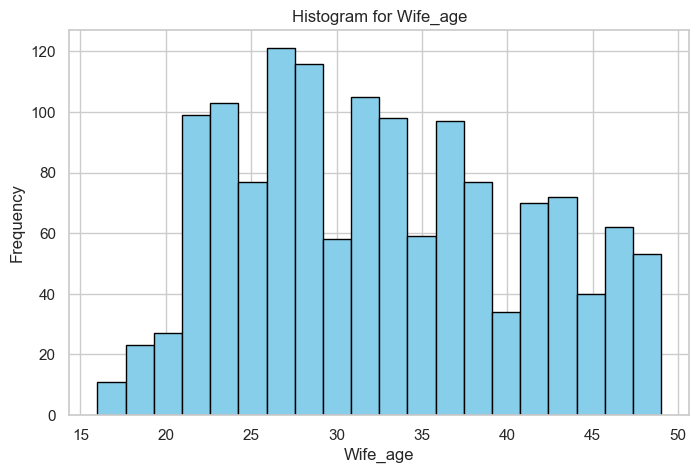

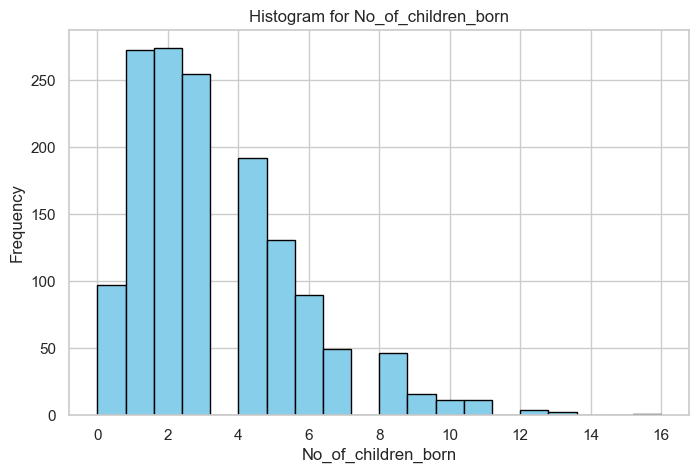

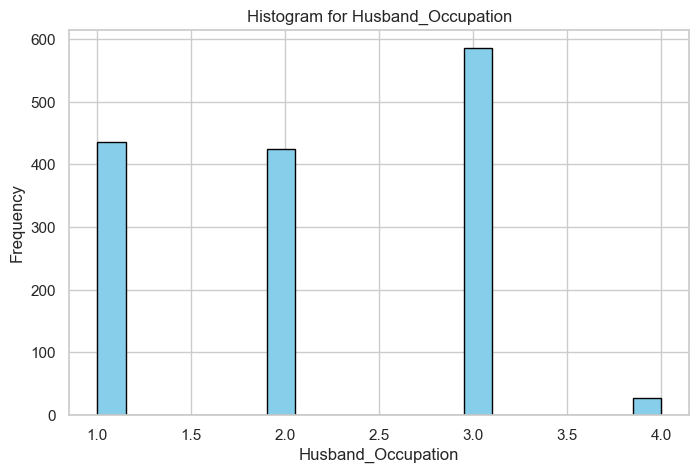

In [526]:
# Select only numerical columns
numeric_columns = concept.select_dtypes(include=['int64', 'float64']).columns

# Plot histograms for numerical columns
for column in numeric_columns:
    plt.figure(figsize=(8, 5))
    plt.hist(concept[column], bins=20, color='skyblue', edgecolor='black')
    plt.title(f'Histogram for {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

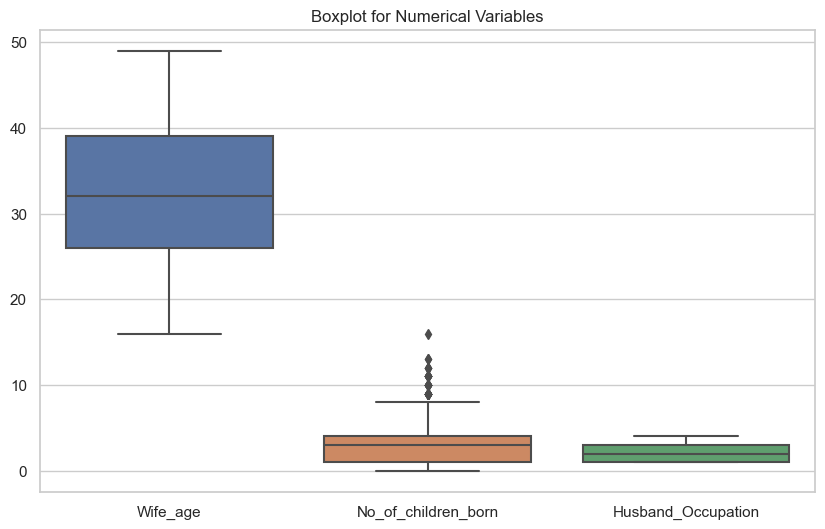

In [527]:
# Separate numerical and categorical columns
numerical_cols = concept.select_dtypes(include='number').columns

# Plot boxplots for numerical variables
plt.figure(figsize=(10, 6))
sns.boxplot(data=concept[numerical_cols])
plt.title('Boxplot for Numerical Variables')
plt.show()

### Univariate analysis for categorical data

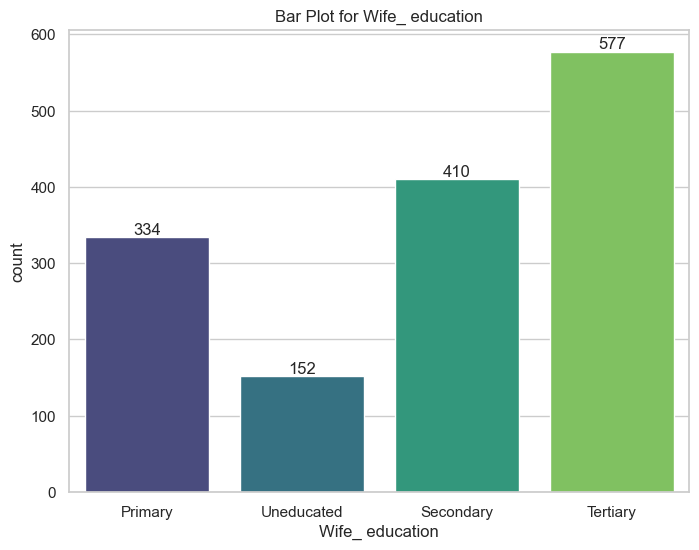

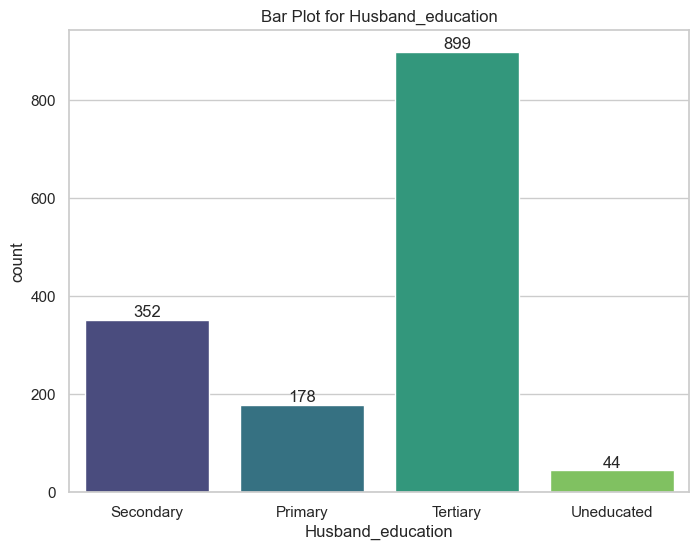

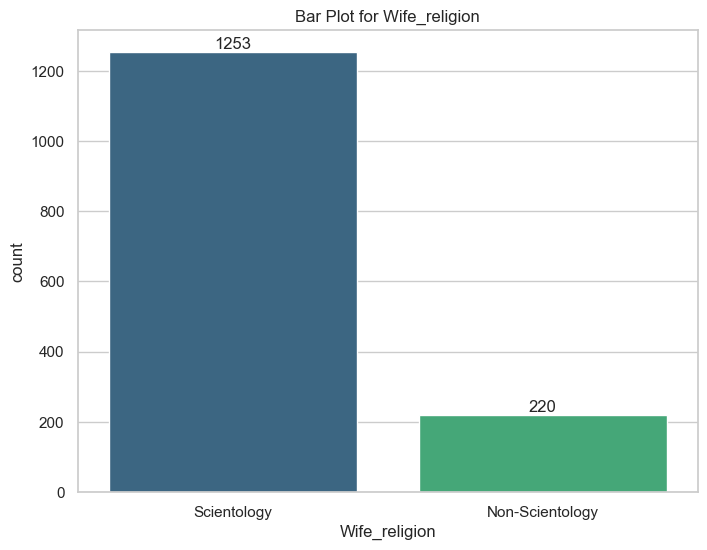

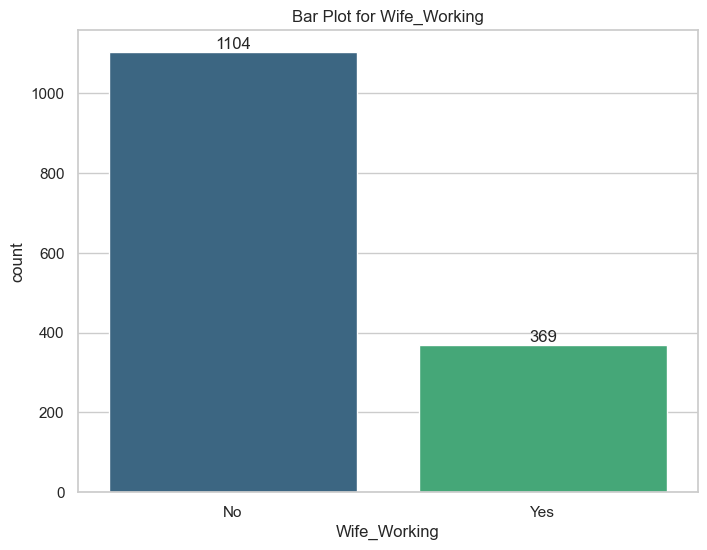

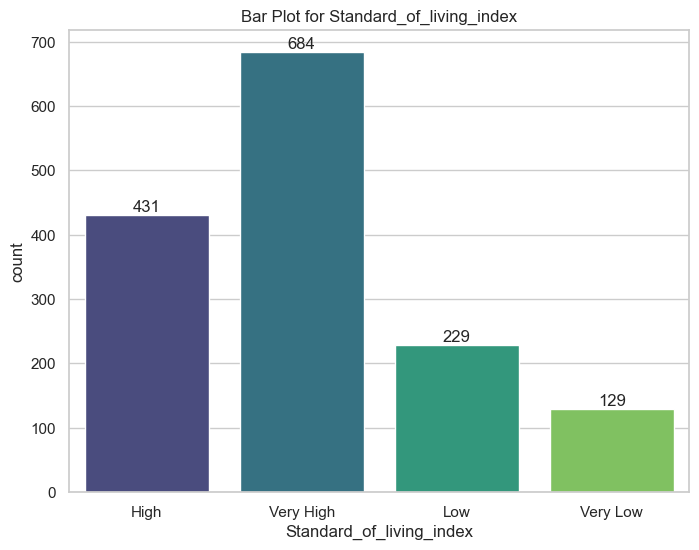

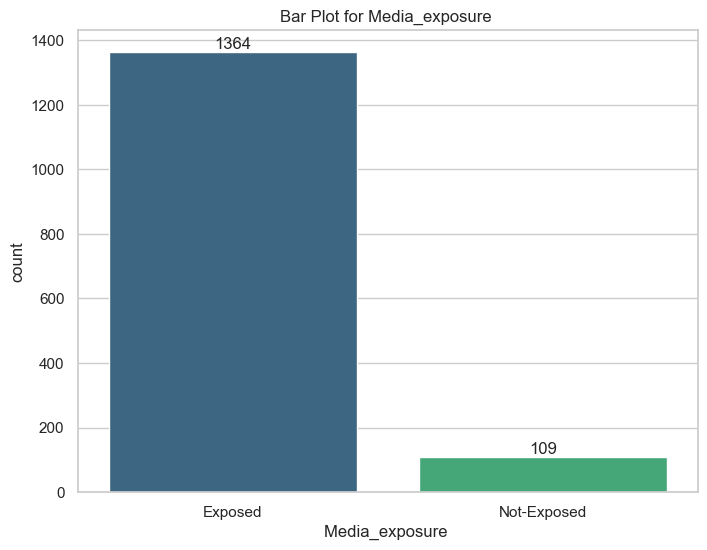

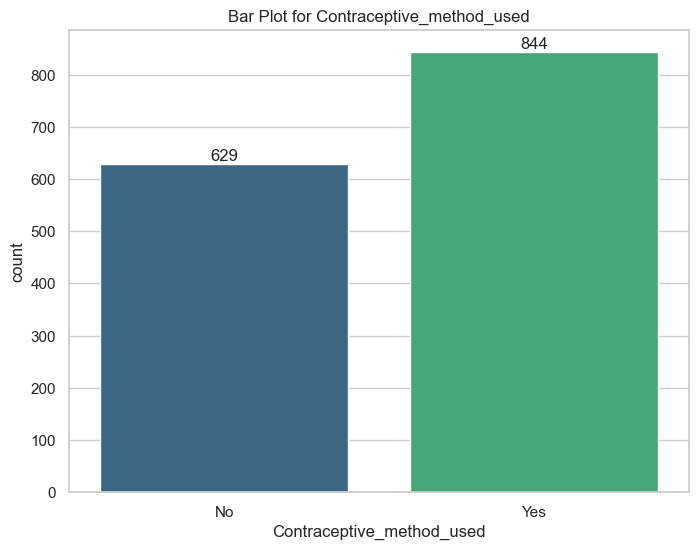

In [409]:
# Identify categorical columns
categorical_columns = concept.select_dtypes(include='object').columns

# Plot bar plots for categorical columns
for column in categorical_columns:
    plt.figure(figsize=(8, 6))
    bar=sns.countplot(x=column, data=concept, palette='viridis')
    plt.bar_label(bar.containers[0])
    plt.title(f'Bar Plot for {column}')
    plt.show()

### Bivariate analysis(Pair-plot) 

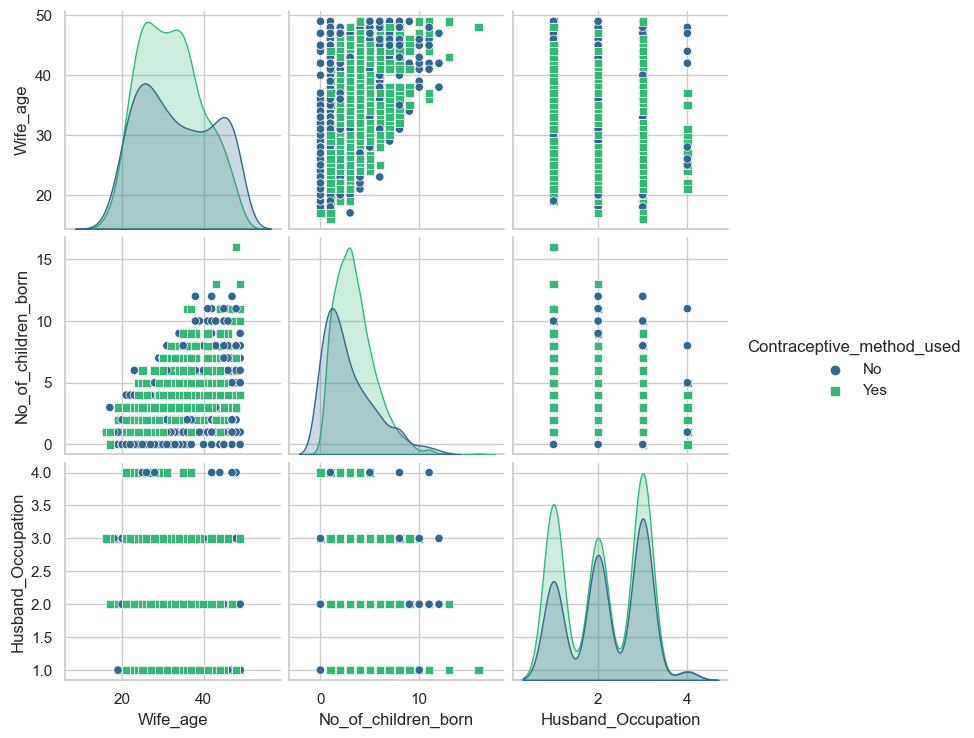

In [412]:
# Create a pairplot with hue for the categorical variable
sns.pairplot(concept, hue='Contraceptive_method_used', markers=["o", "s"], palette='viridis')
plt.show()

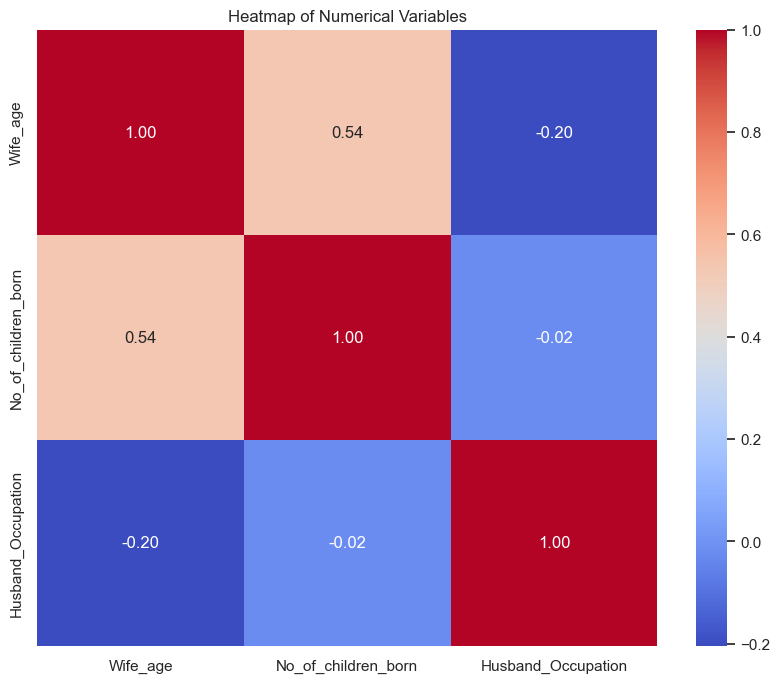

In [416]:
# Select only the numerical variables
numerical_data = concept.select_dtypes(include=['number'])

# Create a heatmap for the numerical variables
plt.figure(figsize=(10, 8))
sns.heatmap(numerical_data.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap of Numerical Variables')
plt.show()

Number of children born and Wife age are slightly correlated.

### Multi-variate analysis:

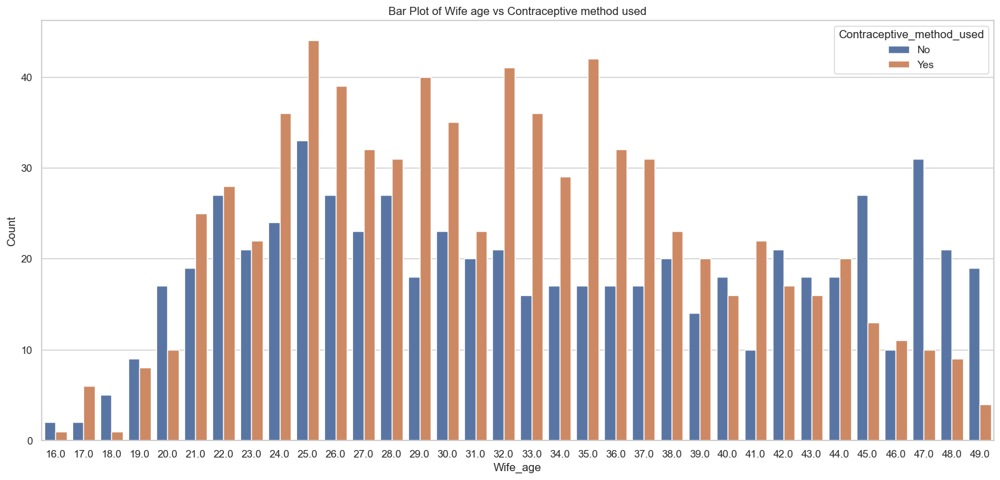

In [459]:
# Multivariate analysis with a bar plot
plt.figure(figsize=(18, 8))
sns.countplot(x='Wife_age', hue='Contraceptive_method_used', data=concept)
plt.xlabel('Wife_age')
plt.ylabel('Count')
plt.title('Bar Plot of Wife age vs Contraceptive method used')
plt.show()

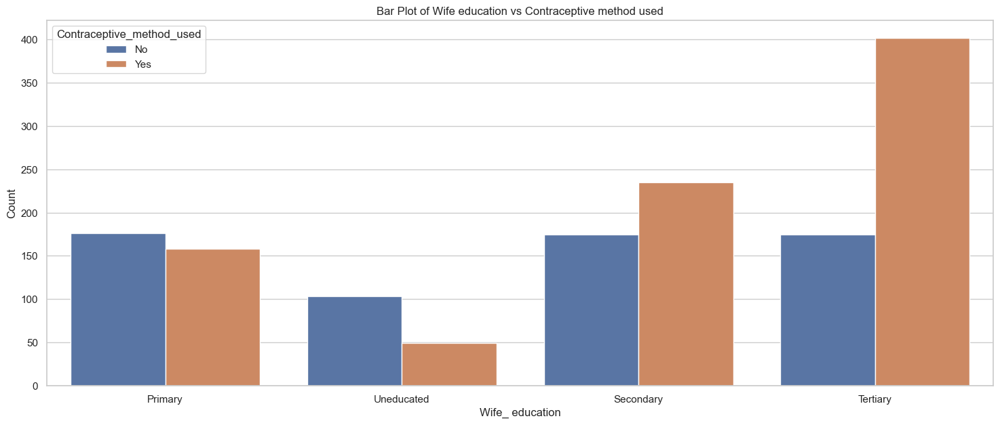

In [457]:
# Multivariate analysis with a bar plot
plt.figure(figsize=(18, 7))
sns.countplot(x='Wife_ education', hue='Contraceptive_method_used', data=concept, palette='deep')
plt.xlabel('Wife_ education')
plt.ylabel('Count')
plt.title('Bar Plot of Wife education vs Contraceptive method used')
plt.show()

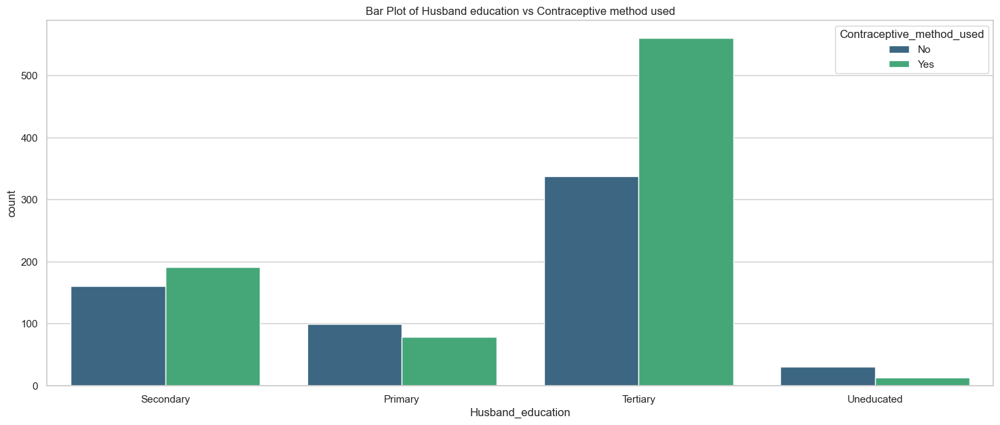

In [456]:
# Multivariate analysis with a bar plot
plt.figure(figsize=(18, 7))
sns.countplot(x='Husband_education', hue='Contraceptive_method_used', data=concept, palette='viridis')
plt.xlabel('Husband_education')
plt.ylabel('count')
plt.title('Bar Plot of Husband education vs Contraceptive method used')
plt.show()

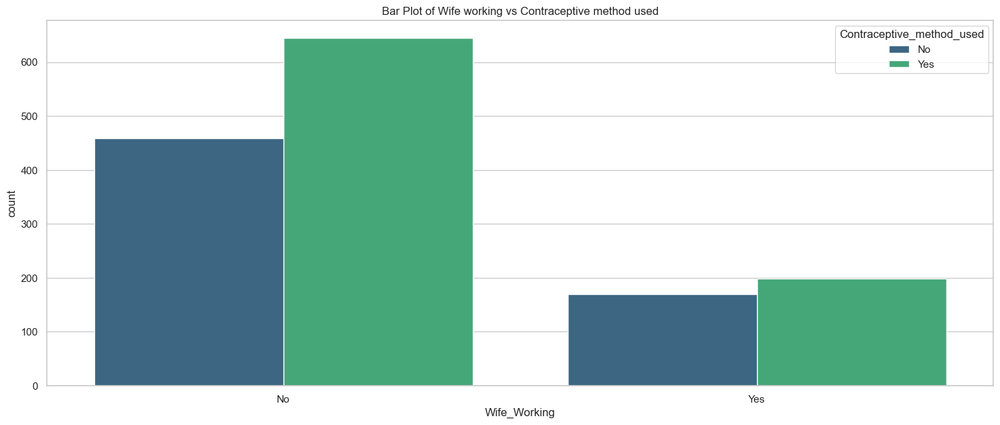

In [455]:
# Multivariate analysis with a bar plot
plt.figure(figsize=(18, 7))
sns.countplot(x='Wife_Working', hue='Contraceptive_method_used', data=concept, palette='viridis')
plt.xlabel('Wife_Working')
plt.ylabel('count')
plt.title('Bar Plot of Wife working vs Contraceptive method used')
plt.show()

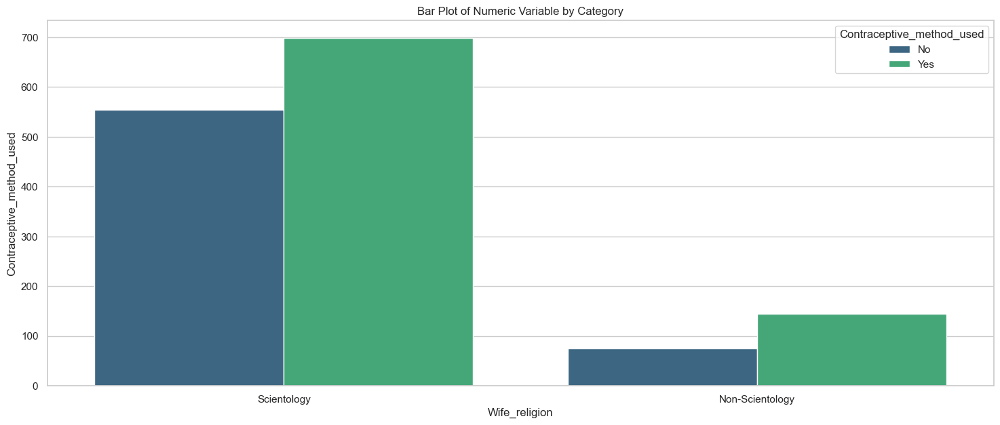

In [447]:
# Multivariate analysis with a bar plot
plt.figure(figsize=(18, 7))
sns.countplot(x='Wife_religion', hue='Contraceptive_method_used', data=concept, palette='viridis')
plt.xlabel('Wife_religion')
plt.ylabel('Contraceptive_method_used')
plt.title('Bar Plot of Numeric Variable by Category')
plt.show()

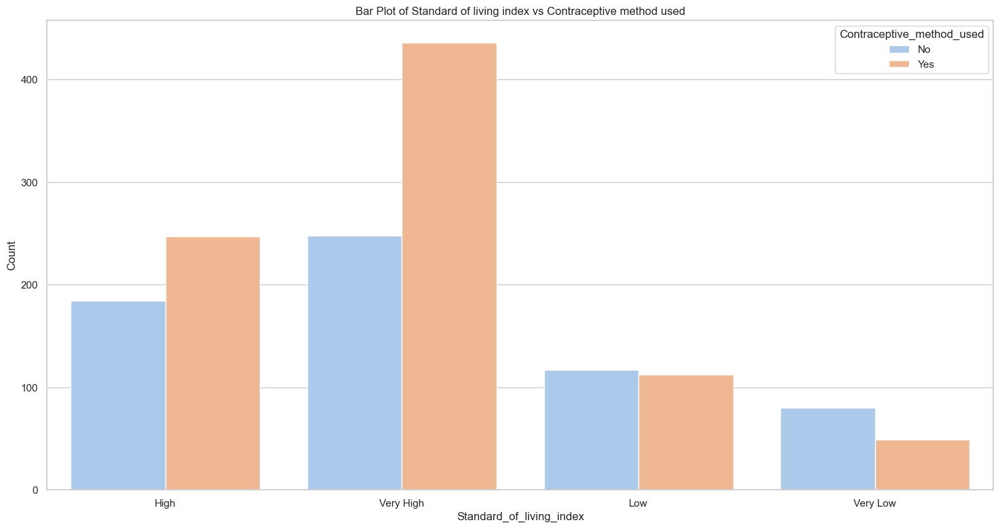

In [460]:
# Multivariate analysis with a bar plot
plt.figure(figsize=(18, 9))
sns.countplot(x='Standard_of_living_index', hue='Contraceptive_method_used', data=concept, palette='pastel')
plt.xlabel('Standard_of_living_index')
plt.ylabel('Count')
plt.title('Bar Plot of Standard of living index vs Contraceptive method used')
plt.show()

### Catplot for categorical vs numerical analysis

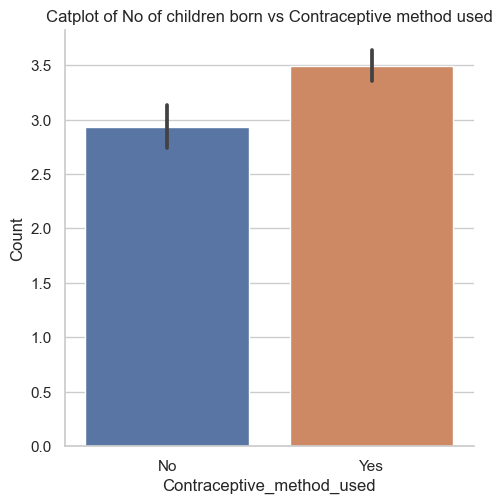

In [461]:
# Create a catplot with a bar plot
sns.catplot(x='Contraceptive_method_used', y='No_of_children_born', data=concept, kind='bar')

# Customize the plot
plt.xlabel('Contraceptive_method_used')
plt.ylabel('Count')
plt.title('Catplot of No of children born vs Contraceptive method used')

plt.show()

### unique values for categorical variables


In [60]:
for column in concept.columns:
    if concept[column].dtype == 'object':
        print(column.upper(),': ',concept[column].nunique())
        print(concept[column].value_counts().sort_values())
        print('\n')

WIFE_ EDUCATION :  4
Uneducated    152
Primary       334
Secondary     410
Tertiary      577
Name: Wife_ education, dtype: int64


HUSBAND_EDUCATION :  4
Uneducated     44
Primary       178
Secondary     352
Tertiary      899
Name: Husband_education, dtype: int64


WIFE_RELIGION :  2
Non-Scientology     220
Scientology        1253
Name: Wife_religion, dtype: int64


WIFE_WORKING :  2
Yes     369
No     1104
Name: Wife_Working, dtype: int64


STANDARD_OF_LIVING_INDEX :  4
Very Low     129
Low          229
High         431
Very High    684
Name: Standard_of_living_index, dtype: int64


MEDIA_EXPOSURE :  2
Not-Exposed     109
Exposed        1364
Name: Media_exposure, dtype: int64


CONTRACEPTIVE_METHOD_USED :  2
No     629
Yes    844
Name: Contraceptive_method_used, dtype: int64




### Problem 2 - Data Pre-processing
Prepare the data for modelling: - Missing value Treatment (if needed) - Outlier Detection(treat, if needed) - Feature Engineering (if needed) - Encode the data - Train-test split

In [61]:
# Are there any missing values ?
concept.isnull().sum()

Wife_age                     71
Wife_ education               0
Husband_education             0
No_of_children_born          21
Wife_religion                 0
Wife_Working                  0
Husband_Occupation            0
Standard_of_living_index      0
Media_exposure                0
Contraceptive_method_used     0
dtype: int64

### Imputing missing values


In [62]:
for column in concept.columns:
    if concept[column].dtype != 'object':
        mean = concept[column].mean()
        concept[column] = concept[column].fillna(mean)    
        
concept.isnull().sum()  

Wife_age                     0
Wife_ education              0
Husband_education            0
No_of_children_born          0
Wife_religion                0
Wife_Working                 0
Husband_Occupation           0
Standard_of_living_index     0
Media_exposure               0
Contraceptive_method_used    0
dtype: int64

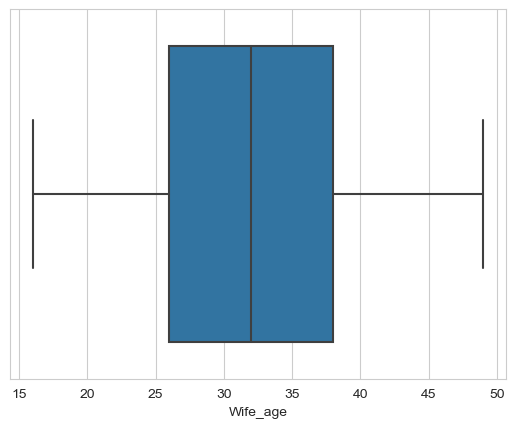

TypeError: Horizontal orientation requires numeric `x` variable.

In [63]:
#Boxlots of numeric variabl

for col in concept.columns:
    sns.boxplot(x=concept[col])
    plt.show()

We observe the outliers are not much for numeric variables. Hence outlier treatment is not required.

In [64]:
# Check for duplicate data

dups = concept.duplicated()
print('Number of duplicate rows = %d' % (dups.sum()))

concept[dups]

Number of duplicate rows = 80


,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
79,38.000000,Tertiary,Tertiary,1.0,Scientology,Yes,1,Very High,Exposed,No
167,26.000000,Tertiary,Tertiary,1.0,Scientology,No,1,Very High,Exposed,No
224,47.000000,Tertiary,Tertiary,4.0,Scientology,No,1,Very High,Exposed,No
270,30.000000,Tertiary,Tertiary,2.0,Scientology,No,1,Very High,Exposed,No
299,26.000000,Tertiary,Tertiary,1.0,Scientology,No,1,Very High,Exposed,No
...,...,...,...,...,...,...,...,...,...,...
1367,44.000000,Tertiary,Tertiary,5.0,Scientology,Yes,1,Very High,Exposed,Yes
1387,32.606277,Secondary,Tertiary,2.0,Scientology,Yes,2,Very High,Exposed,Yes
1423,32.606277,Tertiary,Tertiary,2.0,Non-Scientology,No,1,Very High,Exposed,Yes
1440,32.606277,Tertiary,Tertiary,1.0,Non-Scientology,Yes,2,Very High,Exposed,Yes


In [65]:
concept.duplicated().sum()

80

In [66]:
concept.drop_duplicates(inplace=True)

In [67]:
concept.duplicated().sum()

0

### Check for Object Data Type



In [69]:
concept.select_dtypes(include='object').head(10)

,Wife_ education,Husband_education,Wife_religion,Wife_Working,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,Primary,Secondary,Scientology,No,High,Exposed,No
1,Uneducated,Secondary,Scientology,No,Very High,Exposed,No
2,Primary,Secondary,Scientology,No,Very High,Exposed,No
3,Secondary,Primary,Scientology,No,High,Exposed,No
4,Secondary,Secondary,Scientology,No,Low,Exposed,No
5,Tertiary,Tertiary,Scientology,No,High,Exposed,No
6,Primary,Secondary,Scientology,No,Low,Exposed,No
7,Secondary,Secondary,Scientology,Yes,Low,Exposed,No
8,Primary,Secondary,Scientology,No,Very High,Exposed,No
9,Uneducated,Uneducated,Scientology,No,Low,Not-Exposed,No


It seems that the columns Wife_ education, Husband_education , Wife_religion, Wife_Working, Standard_of_living_index, Media_exposure and Contraceptive_method_used needs to be cleaned and converted to Float/int dtype

### Find the Distribution of Dependent Variable Categories

In [70]:
count_no_sub = len(concept[concept['Contraceptive_method_used']=='No'])
count_sub = len(concept[concept['Contraceptive_method_used']=='Yes'])
pct_of_no_sub = count_no_sub/(count_no_sub+count_sub)
print("percentage of no Contraceptive_method_used is", pct_of_no_sub*100)
pct_of_sub = count_sub/(count_no_sub+count_sub)
print("percentage of Contraceptive_method_used", pct_of_sub*100)

percentage of no Contraceptive_method_used is 44.077530509691314
percentage of Contraceptive_method_used 55.92246949030869


In [71]:
for column in concept.columns:
    if concept[column].dtype == 'object':
        print(column.upper(),': ',concept[column].nunique())
        print(concept[column].value_counts().sort_values())
        print('\n')

WIFE_ EDUCATION :  4
Uneducated    150
Primary       330
Secondary     398
Tertiary      515
Name: Wife_ education, dtype: int64


HUSBAND_EDUCATION :  4
Uneducated     44
Primary       175
Secondary     347
Tertiary      827
Name: Husband_education, dtype: int64


WIFE_RELIGION :  2
Non-Scientology     207
Scientology        1186
Name: Wife_religion, dtype: int64


WIFE_WORKING :  2
Yes     350
No     1043
Name: Wife_Working, dtype: int64


STANDARD_OF_LIVING_INDEX :  4
Very Low     129
Low          227
High         419
Very High    618
Name: Standard_of_living_index, dtype: int64


MEDIA_EXPOSURE :  2
Not-Exposed     109
Exposed        1284
Name: Media_exposure, dtype: int64


CONTRACEPTIVE_METHOD_USED :  2
No     614
Yes    779
Name: Contraceptive_method_used, dtype: int64




# Convert Object Feature types for Linear Discriminant Analysis

In [72]:
concept['Wife_ education']=np.where(concept['Wife_ education'] =='Uneducated', 1, concept['Wife_ education'])
concept['Wife_ education']=np.where(concept['Wife_ education'] =='Primary', 2, concept['Wife_ education'])
concept['Wife_ education']=np.where(concept['Wife_ education'] =='Secondary', 3, concept['Wife_ education'])
concept['Wife_ education']=np.where(concept['Wife_ education'] =='Tertiary', 4, concept['Wife_ education'])

In [73]:
concept['Husband_education']=np.where(concept['Husband_education'] =='Uneducated', 1, concept['Husband_education'])
concept['Husband_education']=np.where(concept['Husband_education'] =='Primary', 2, concept['Husband_education'])
concept['Husband_education']=np.where(concept['Husband_education'] =='Secondary', 3, concept['Husband_education'])
concept['Husband_education']=np.where(concept['Husband_education'] =='Tertiary', 4, concept['Husband_education'])

In [74]:
concept['Wife_Working']=np.where(concept['Wife_Working'] =='Yes', 1, concept['Wife_Working'])
concept['Wife_Working']=np.where(concept['Wife_Working'] =='No', 2, concept['Wife_Working'])

In [75]:
concept['Wife_religion']=np.where(concept['Wife_religion'] =='Scientology', 1, concept['Wife_religion'])
concept['Wife_religion']=np.where(concept['Wife_religion'] =='Non-Scientology', 2, concept['Wife_religion'])

In [76]:
concept['Media_exposure']=np.where(concept['Media_exposure'] =='Exposed', 1, concept['Media_exposure'])
concept['Media_exposure']=np.where(concept['Media_exposure'] =='Not-Exposed', 2, concept['Media_exposure'])

In [77]:
concept['Standard_of_living_index']=np.where(concept['Standard_of_living_index'] =='Very Low', 1, concept['Standard_of_living_index'])
concept['Standard_of_living_index']=np.where(concept['Standard_of_living_index'] =='Low', 2, concept['Standard_of_living_index'])
concept['Standard_of_living_index']=np.where(concept['Standard_of_living_index'] =='High', 3, concept['Standard_of_living_index'])
concept['Standard_of_living_index']=np.where(concept['Standard_of_living_index'] =='Very High', 4, concept['Standard_of_living_index'])

In [78]:
concept['Contraceptive_method_used']=np.where(concept['Contraceptive_method_used'] =='Yes', 1, concept['Contraceptive_method_used'])
concept['Contraceptive_method_used']=np.where(concept['Contraceptive_method_used'] =='No', 0, concept['Contraceptive_method_used'])

In [79]:
concept.head(10)

,Wife_age,Wife_ education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,24.0,2,3,3.0,1,2,2,3,1,0
1,45.0,1,3,10.0,1,2,3,4,1,0
2,43.0,2,3,7.0,1,2,3,4,1,0
3,42.0,3,2,9.0,1,2,3,3,1,0
4,36.0,3,3,8.0,1,2,3,2,1,0
5,19.0,4,4,0.0,1,2,3,3,1,0
6,38.0,2,3,6.0,1,2,3,2,1,0
7,21.0,3,3,1.0,1,1,3,2,1,0
8,27.0,2,3,3.0,1,2,3,4,1,0
9,45.0,1,1,8.0,1,2,2,2,2,0


Encoded the categorical variables Wife_ education, Husband_education, Wife_religion,Standard_of_living_index, Media_exposure and Contraceptive_method_used in the ascending orderfrom worst to best since LDA does not take string variables as parameters into model building. 

Below isthe encoding for ordinal values:Wife_ education: Uneducated = 1, Primary = 2, Secondary = 3, Tertiary = 4.

Husband_education: Uneducated = 1, Primary = 2, Secondary = 3, Tertiary = 4.

Wife_religion: Scientology = 1 and non-Scientology = 2.

Wife_Working: Yes = 1 and No = 2.

Standard_of_living _index: Very Low = 1, Low = 2, High = 3, Very High = 4.

Media_exposure: Exposed = 1 and Not-Exposed = 2.

Contraceptive_method_used: Yes = 1 and No = 0.

In [80]:
concept.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Wife_age,1393.0,NaN,NaN,NaN,32.559670,8.087315,16.0,26.0,32.0,38.0,49.0
Wife_ education,1393.0,4.0,4.0,515.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Husband_education,1393.0,4.0,4.0,827.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
No_of_children_born,1393.0,NaN,NaN,NaN,3.290263,2.381531,0.0,1.0,3.0,5.0,16.0
Wife_religion,1393.0,2.0,1.0,1186.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Wife_Working,1393.0,2.0,2.0,1043.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Husband_Occupation,1393.0,NaN,NaN,NaN,2.174444,0.854590,1.0,1.0,2.0,3.0,4.0
Standard_of_living_index,1393.0,4.0,4.0,618.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Media_exposure,1393.0,2.0,1.0,1284.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Contraceptive_method_used,1393.0,2.0,1.0,779.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [81]:
concept.describe().T

,count,mean,std,min,25%,50%,75%,max
Wife_age,1393.0,32.559670,8.087315,16.0,26.0,32.0,38.0,49.0
No_of_children_born,1393.0,3.290263,2.381531,0.0,1.0,3.0,5.0,16.0
Husband_Occupation,1393.0,2.174444,0.854590,1.0,1.0,2.0,3.0,4.0


In [82]:
concept.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1393 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1393 non-null   float64
 1   Wife_ education            1393 non-null   object 
 2   Husband_education          1393 non-null   object 
 3   No_of_children_born        1393 non-null   float64
 4   Wife_religion              1393 non-null   object 
 5   Wife_Working               1393 non-null   object 
 6   Husband_Occupation         1393 non-null   int64  
 7   Standard_of_living_index   1393 non-null   object 
 8   Media_exposure             1393 non-null   object 
 9   Contraceptive_method_used  1393 non-null   object 
dtypes: float64(2), int64(1), object(7)
memory usage: 119.7+ KB


In [83]:
## Converting the object columns in to int64 datatype

concept['Contraceptive_method_used']= concept['Contraceptive_method_used'].astype('int64')
concept['Wife_ education']= concept['Wife_ education'].astype('int64')
concept['Husband_education']= concept['Husband_education'].astype('int64')
concept['Wife_religion']= concept['Wife_religion'].astype('int64')
concept['Standard_of_living_index']= concept['Standard_of_living_index'].astype('int64')
concept['Media_exposure']= concept['Media_exposure'].astype('int64')
concept['Wife_Working']= concept['Wife_Working'].astype('int64')

In [84]:
concept.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1393 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1393 non-null   float64
 1   Wife_ education            1393 non-null   int64  
 2   Husband_education          1393 non-null   int64  
 3   No_of_children_born        1393 non-null   float64
 4   Wife_religion              1393 non-null   int64  
 5   Wife_Working               1393 non-null   int64  
 6   Husband_Occupation         1393 non-null   int64  
 7   Standard_of_living_index   1393 non-null   int64  
 8   Media_exposure             1393 non-null   int64  
 9   Contraceptive_method_used  1393 non-null   int64  
dtypes: float64(2), int64(8)
memory usage: 119.7 KB


### Train Test Split


In [97]:
# Copy all the predictor variables into X dataframe
X = concept.drop('Contraceptive_method_used', axis=1)

# Copy target into the y dataframe. 
y = concept['Contraceptive_method_used']

In [98]:
y.value_counts()

1    779
0    614
Name: Contraceptive_method_used, dtype: int64

In [99]:
# Split X and y into training and test set in 70:30 ratio
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30 , random_state=1,stratify=concept['Contraceptive_method_used'])

In [100]:
print('Number of rows and columns of the training set for the independent variables:',X_train.shape)
print('Number of rows and columns of the training set for the dependent variable:',y_train.shape)
print('Number of rows and columns of the test set for the independent variables:',X_test.shape)
print('Number of rows and columns of the test set for the dependent variable:',y_test.shape)

Number of rows and columns of the training set for the independent variables: (975, 9)
Number of rows and columns of the training set for the dependent variable: (975,)
Number of rows and columns of the test set for the independent variables: (418, 9)
Number of rows and columns of the test set for the dependent variable: (418,)


In [101]:
y_train.value_counts(1)

1    0.558974
0    0.441026
Name: Contraceptive_method_used, dtype: float64

In [102]:
y_test.value_counts(1)

1    0.559809
0    0.440191
Name: Contraceptive_method_used, dtype: float64

### Problem 2 - Model Building and Compare the Performance of the Models
- Build a Logistic Regression model - Build a Linear Discriminant Analysis model - Build a CART model - Prune the CART model by finding the best hyperparameters using GridSearch - Check the performance of the models across train and test set using different metrics - Compare the performance of all the models built and choose the best one with proper rationale

### Logistic Regression Model

In [104]:
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import roc_auc_score,roc_curve,classification_report,confusion_matrix,ConfusionMatrixDisplay

# Fit the Logistic Regression model
model = LogisticRegression(solver='newton-cg',max_iter=10000,penalty='none',verbose=True,n_jobs=2)
model.fit(X_train, y_train)

C:\Users\admin\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:1182: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   1 out of   1 | elapsed:   27.9s finished


LogisticRegression(max_iter=10000, n_jobs=2, penalty='none', solver='newton-cg',
                   verbose=True)

### Predicting on Training and Test dataset

In [105]:
ytrain_predict = model.predict(X_train)
ytest_predict = model.predict(X_test)

### Getting the Predicted Classes and Probs

In [106]:
ytest_predict_prob=model.predict_proba(X_test)
pd.DataFrame(ytest_predict_prob).head()

,0,1
0,0.284744,0.715256
1,0.615996,0.384004
2,0.336325,0.663675
3,0.299149,0.700851
4,0.245245,0.754755


### Model Evaluation

In [107]:
# Accuracy - Training Data
model.score(X_train, y_train)

0.6738461538461539

### AUC Value closer to 1 tells that there is good seperatibility between the predicted classes and thus the model is good for prediction

### ROC Curve visually represents the above concept where the plot should be as far as possible from the diagnol.

### AUC and ROC for the training data


AUC: 0.719


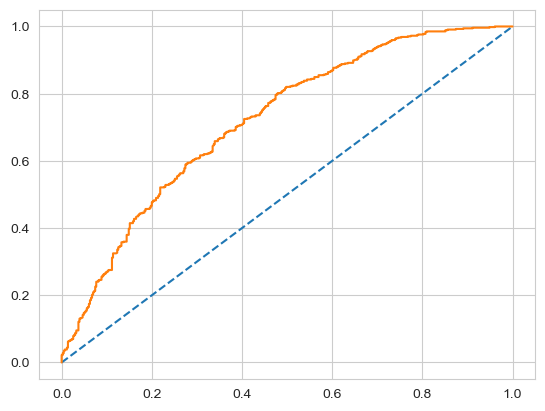

In [108]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
train_fpr, train_tpr, train_thresholds = roc_curve(y_train, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(train_fpr, train_tpr);

In [109]:
# Accuracy - Test Data
model.score(X_test, y_test)

0.645933014354067

### AUC and ROC for the test data

AUC: 0.719


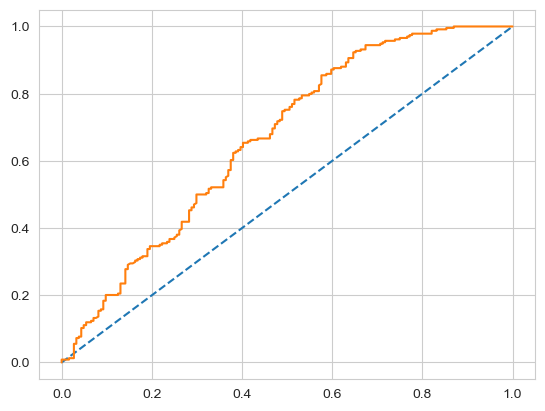

In [110]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
test_auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
test_fpr, test_tpr, test_thresholds = roc_curve(y_test, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(test_fpr, test_tpr);

### Confusion Matrix for the training data

In [111]:
confusion_matrix(y_train, ytrain_predict)

array([[226, 204],
       [114, 431]], dtype=int64)

In [112]:
cm = confusion_matrix(y_train, ytrain_predict)
cm

array([[226, 204],
       [114, 431]], dtype=int64)

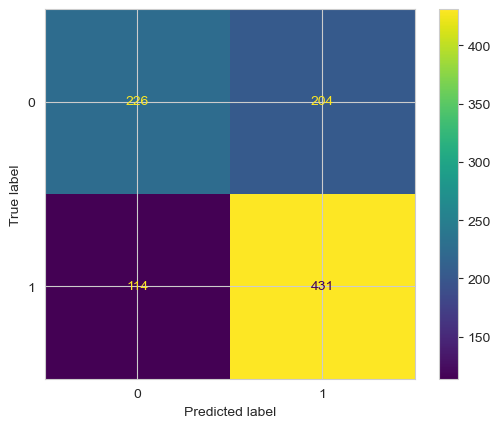

In [113]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
disp.plot()

In [114]:
print(classification_report(y_train, ytrain_predict))

              precision    recall  f1-score   support

           0       0.66      0.53      0.59       430
           1       0.68      0.79      0.73       545

    accuracy                           0.67       975
   macro avg       0.67      0.66      0.66       975
weighted avg       0.67      0.67      0.67       975



### Confusion Matrix for test data

In [115]:
confusion_matrix(y_test, ytest_predict)

array([[ 84, 100],
       [ 48, 186]], dtype=int64)

In [116]:
cm = confusion_matrix(y_test, ytest_predict)
cm

array([[ 84, 100],
       [ 48, 186]], dtype=int64)

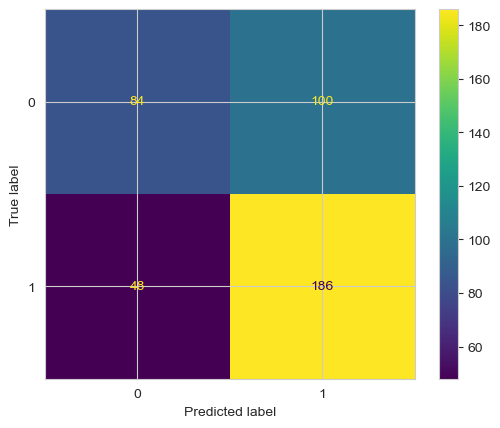

In [117]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
disp.plot()

In [118]:
print(classification_report(y_test, ytest_predict))

              precision    recall  f1-score   support

           0       0.64      0.46      0.53       184
           1       0.65      0.79      0.72       234

    accuracy                           0.65       418
   macro avg       0.64      0.63      0.62       418
weighted avg       0.64      0.65      0.63       418



### Applying GridSearchCV for Logistic Regression

In [119]:
grid={'penalty':['l2','none'],
      'solver':['sag','lbfgs'],
      'tol':[0.0001,0.00001]}

In [120]:
model = LogisticRegression(max_iter=10000,n_jobs=2)

In [121]:
grid_search = GridSearchCV(estimator = model, param_grid = grid, cv = 3,n_jobs=-1,scoring='f1')

In [122]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=LogisticRegression(max_iter=10000, n_jobs=2),
             n_jobs=-1,
             param_grid={'penalty': ['l2', 'none'], 'solver': ['sag', 'lbfgs'],
                         'tol': [0.0001, 1e-05]},
             scoring='f1')

In [123]:
print(grid_search.best_params_,'\n')
print(grid_search.best_estimator_)

{'penalty': 'l2', 'solver': 'sag', 'tol': 0.0001} 

LogisticRegression(max_iter=10000, n_jobs=2, solver='sag')


In [124]:
best_model = grid_search.best_estimator_

In [125]:
# Prediction on the training set

ytrain_predict = best_model.predict(X_train)
ytest_predict = best_model.predict(X_test)

In [126]:
## Getting the probabilities on the test set

ytest_predict_prob=best_model.predict_proba(X_test)
pd.DataFrame(ytest_predict_prob).head()

,0,1
0,0.283026,0.716974
1,0.613150,0.386850
2,0.336989,0.663011
3,0.300239,0.699761
4,0.249101,0.750899


In [127]:
## Confusion matrix on the training data
cm = confusion_matrix(y_train, ytrain_predict)
cm

array([[225, 205],
       [110, 435]], dtype=int64)

              precision    recall  f1-score   support

           0       0.67      0.52      0.59       430
           1       0.68      0.80      0.73       545

    accuracy                           0.68       975
   macro avg       0.68      0.66      0.66       975
weighted avg       0.68      0.68      0.67       975
 



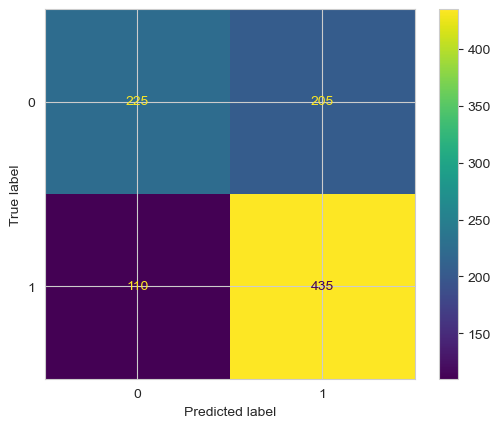

In [128]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_model.classes_)
disp.plot()
print(classification_report(y_train, ytrain_predict),'\n');

              precision    recall  f1-score   support

           0       0.64      0.46      0.53       184
           1       0.65      0.79      0.72       234

    accuracy                           0.65       418
   macro avg       0.64      0.63      0.62       418
weighted avg       0.64      0.65      0.63       418
 



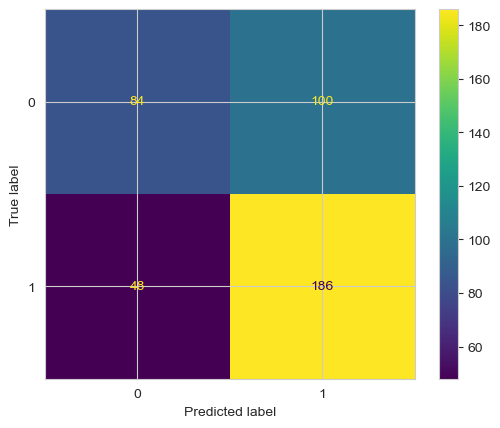

In [129]:
## Confusion matrix on the test data
cm = confusion_matrix(y_test, ytest_predict)
cm
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_model.classes_)
disp.plot()
print(classification_report(y_test, ytest_predict),'\n');

In [130]:
from sklearn.metrics import confusion_matrix
tn, fp, fn, tp = confusion_matrix(y_test, ytest_predict).ravel()

In [131]:
tn,fp,fn,tp

(84, 100, 48, 186)

In [132]:
(tp+tn)/(tp+tn+fp+fn)# ACCURACY of predicting 0's and 1's correctly 

0.645933014354067

In [133]:
tp/(tp+fp)#Precision for 1's

0.6503496503496503

In [134]:
tp/(tp+fn)#Recall for 1's

0.7948717948717948

Note :
Precison: tells us how many predictions are actually positive out of all the total positive predicted.

Recall: how many observations of positive class are actually predicted as positive. 



### Inferences :
For predicting Contraceptive method used= NO(Label 0 ):

Precision (64%) – It is predicted that 64% of the total population of women in the dataset have not used Contraceptive methods. 

Recall (46%) – Out of the total population of all the women in the dataset, 46% of the population data have not used contraceptive methods are predicted correctly .

For predicting Contraceptive method used= Yes (Label 1 ):

Precision (65%) – It is predicted that 65% of the total population of women in the dataset have used Contraceptive methods.

Recall (79%) – Out of the total population of all the women in the dataset, 79% of the population data have used contraceptive methods are predicted correctly .


### Overall accuracy of the model – 65 % of total predictions are correct

Accuracy= 0.645933014354067, 

AUC= 0.719, 

Precision (0)= 0.64 

Precision (1)= 0.65  

Recall (0)= 0.46

Recall (1)= 0.79 for test data 

Accuracy= 0.6738461538461539, 

AUC= 0.719, 

Precision (0)= 0.66 

Precision (1)= 0.68  

Recall (0)= 0.53

Recall (1)= 0.79 for training  data

is almost inline with training data. This proves no overfitting or underfitting has happened, and overall the model is a good model for classification


### Linear Discriminant Analysis (LDA)

In [135]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn import metrics,model_selection
from sklearn.metrics import roc_auc_score,roc_curve,classification_report,confusion_matrix,ConfusionMatrixDisplay

In [136]:
print('Number of rows and columns of the training set for the independent variables:',X_train.shape)
print('Number of rows and columns of the training set for the dependent variable:',y_train.shape)
print('Number of rows and columns of the test set for the independent variables:',X_test.shape)
print('Number of rows and columns of the test set for the dependent variable:',y_test.shape)

Number of rows and columns of the training set for the independent variables: (975, 9)
Number of rows and columns of the training set for the dependent variable: (975,)
Number of rows and columns of the test set for the independent variables: (418, 9)
Number of rows and columns of the test set for the dependent variable: (418,)


### LDA Model

In [137]:
#Build LDA Model and fit the data
clf = LinearDiscriminantAnalysis()
model = clf.fit(X_train,y_train)

### Prediction

In [138]:
# Training Data Class Prediction with a cut-off value of 0.5 as default
pred_class_train = model.predict(X_train)
# Test Data Class Prediction with a cut-off value of 0.5 as default
pred_class_test = model.predict(X_test)

### Training Data and Test Data Confusion Matrix Comparison

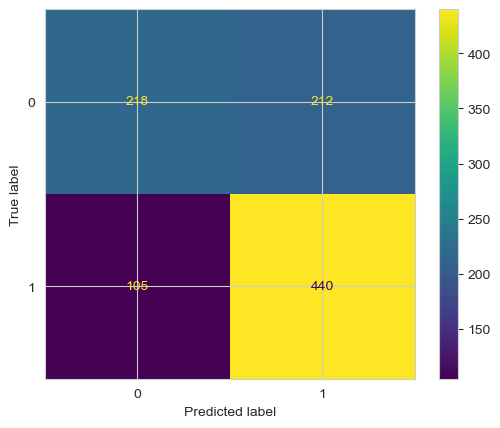

In [139]:
#Plotting confusion matrix for the different models for the Training Data
cm = metrics.confusion_matrix(y_train,pred_class_train)
disp = metrics.ConfusionMatrixDisplay(cm,display_labels = model.classes_)
disp.plot()

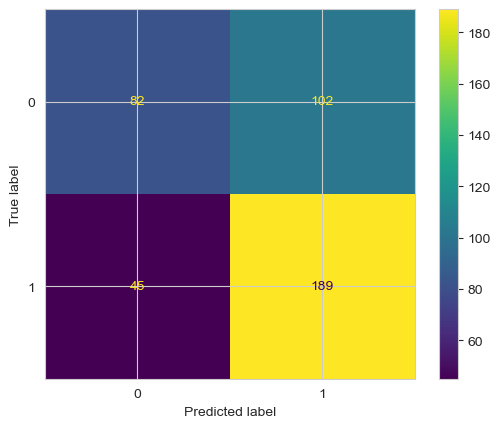

In [140]:
#Plotting confusion matrix for the different models for the testing Data
cm = metrics.confusion_matrix(y_test,pred_class_test)
disp = metrics.ConfusionMatrixDisplay(cm,display_labels = model.classes_)
disp.plot()

### Training Data and Test Data Classification Report Comparison

In [141]:
print(metrics.classification_report(y_train,pred_class_train))

              precision    recall  f1-score   support

           0       0.67      0.51      0.58       430
           1       0.67      0.81      0.74       545

    accuracy                           0.67       975
   macro avg       0.67      0.66      0.66       975
weighted avg       0.67      0.67      0.67       975



In [142]:
print(metrics.classification_report(y_test,pred_class_test))

              precision    recall  f1-score   support

           0       0.65      0.45      0.53       184
           1       0.65      0.81      0.72       234

    accuracy                           0.65       418
   macro avg       0.65      0.63      0.62       418
weighted avg       0.65      0.65      0.64       418



### Probability prediction for the training and test data

In [144]:
# Training Data Probability Prediction
pred_prob_train = model.predict_proba(X_train)

# Test Data Probability Prediction
pred_prob_test = model.predict_proba(X_test)

### AUC and ROC 

AUC for the Training Data: 0.719
AUC for the Test Data: 0.664


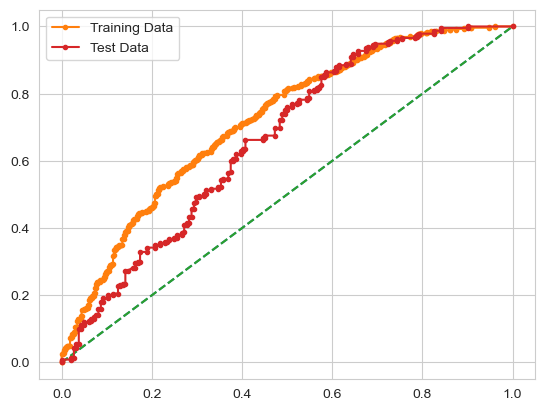

In [147]:
# AUC and ROC for the training data

# calculate AUC
auc = metrics.roc_auc_score(y_train,pred_prob_train[:,1])
print('AUC for the Training Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(y_train,pred_prob_train[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label = 'Training Data')


# AUC and ROC for the test data

# calculate AUC
auc = metrics.roc_auc_score(y_test,pred_prob_test[:,1])
print('AUC for the Test Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(y_test,pred_prob_test[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label='Test Data')
# show the plot
plt.legend(loc='best')
plt.show()

In [148]:
pred_prob_train[:,1]

array([0.31404421, 0.81674757, 0.81206159, 0.61259337, 0.27849383,
       0.53582135, 0.52123075, 0.31009506, 0.84361564, 0.69702015,
       0.62185258, 0.76111532, 0.57043386, 0.85761023, 0.86934023,
       0.76692793, 0.75811017, 0.46092184, 0.42279295, 0.73196776,
       0.65465706, 0.64930513, 0.70371623, 0.16296779, 0.510433  ,
       0.44092797, 0.64136599, 0.3801063 , 0.32017332, 0.60085995,
       0.34901436, 0.50388772, 0.32834985, 0.69092747, 0.53936483,
       0.73516373, 0.27667068, 0.516706  , 0.53585583, 0.7045902 ,
       0.69930696, 0.45515469, 0.20397729, 0.5225128 , 0.30221366,
       0.42336251, 0.72454929, 0.35399103, 0.57002618, 0.75438431,
       0.22186621, 0.6638417 , 0.78412287, 0.34305143, 0.59361882,
       0.63703016, 0.66798386, 0.46607229, 0.35908676, 0.70473077,
       0.76391605, 0.50012789, 0.2662814 , 0.57695036, 0.50548632,
       0.41794356, 0.5927456 , 0.20252551, 0.2804659 , 0.2540093 ,
       0.52439722, 0.49901082, 0.47295338, 0.6042131 , 0.64107

### Inferences

### Note :
Preson : tells us how many predictions are actually positive ot of all the total positive predicted.

Recall   : how many observations of positive class are actually predicted as positive. 

### Inferences using the default value 0.5 for cut-off for test data

### For Women who did not use the Contraceptive method (Label 0):

Precision (65%) 65% of women who did not use Contraceptive method are corectly predicted, out of all the women who did not use the Contraceptive method are predicted.

Recall (65%) 65% of women who actually did not use Contraceptive method, 45% of women who did not use Contraceptive method have been predicted correctly.


### For Women who did use the Contraceptive method (Label 1):

Precision (45%)- 45% ofwomen who did use Contraceptive method are correctly predicted, out of all the owmen who did use the Contraceptive method that are predicted.

Recall (81%)- 81% out of all the women who actually did use Contraceptive methos, 81% of women who did use the Contraceptive method have been predicted correctly.

Overall accuracy of the model- 65% of total predictions are correct. 

Accuracy= 0.65,

AUC= 0.664,

Precision (0)= 0.65

Precision (1)= 0.65

Recall (0)= 0.45

Recall (1)= 0.81 for test data

Accuracy= 0.67,

AUC= 0.719,

Precision (0)= 0.67

Precision (1)= 0.67

Recall (0)= 0.51

Recall (1)= 0.81 for training data

is almost in line with training data. This proves no overfitting or underfitting has happened, and overall, the model is a good model for classification.

### Generate Coefficients and intercept for the Linear Discriminant Function

In [149]:
#intercept value
clf.intercept_ 

array([-1.7472587])

In [150]:
#coefficients for the Linear Discriminant Function
clf.coef_

array([[-0.07224645,  0.51718   ,  0.03788386,  0.31065607,  0.44709404,
         0.17154876,  0.14115772,  0.31767495, -0.34639251]])

In [151]:
X.columns

Index(['Wife_age', 'Wife_ education', 'Husband_education',
       'No_of_children_born', 'Wife_religion', 'Wife_Working',
       'Husband_Occupation', 'Standard_of_living_index', 'Media_exposure'],
      dtype='object')

In [152]:
a=clf.coef_
np.round(a,2) # rounded up coefficients

array([[-0.07,  0.52,  0.04,  0.31,  0.45,  0.17,  0.14,  0.32, -0.35]])

By the above equation and the coefficients it is clear that

predictor 'Wife_ education' has the largest magnitude thus this helps in classifying the best

predictor 'Media_exposure' has the smallest magnitude thus this helps in classifying the least

### Using LDA for Dimensionality Reduction

In [154]:
lda_model = LinearDiscriminantAnalysis(n_components = 1)# as only two classes are there for prediction thus 2-1=1 component
X_train_lda = lda_model.fit_transform(X_train, y_train)
X_test_lda = lda_model.transform(X_test)

In [155]:
print(X_train_lda.shape)
print(X_test_lda.shape)

(975, 1)
(418, 1)


The output above confirms we only have 1 feature for all the records in our training and test sets

In [156]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
model.fit(X_train_lda, y_train)
y_pred = model.predict(X_test_lda)

The output below shows that with only a single feature, our machine learning model achieves an accuracy of 64% which is almost same as the accuracy achieved using all the features.

In [157]:
print('Classification Report of the test data:\n\n',metrics.classification_report(y_test,y_pred),'\n')

Classification Report of the test data:

               precision    recall  f1-score   support

           0       0.63      0.46      0.53       184
           1       0.65      0.79      0.71       234

    accuracy                           0.64       418
   macro avg       0.64      0.62      0.62       418
weighted avg       0.64      0.64      0.63       418
 



In [609]:
# Logistic Regression model
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score,roc_curve,classification_report,confusion_matrix,ConfusionMatrixDisplay
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
logreg_model = LogisticRegression()
logreg_model.fit(X_train, y_train)
logreg_predictions = logreg_model.predict(X_test)
logreg_accuracy = accuracy_score(y_test, logreg_predictions)
print(f'Logistic Regression Accuracy: {logreg_accuracy:.2f}')

Logistic Regression Accuracy: 0.65


In [572]:
# Linear Discriminant Analysis model
lda_model = LinearDiscriminantAnalysis()
lda_model.fit(X_train, y_train)
lda_predictions = lda_model.predict(X_test)
lda_accuracy = accuracy_score(y_test, lda_predictions)
print(f'Linear Discriminant Analysis Accuracy: {lda_accuracy:.2f}')

Linear Discriminant Analysis Accuracy: 0.65


In [573]:
# CART model (Decision Tree)
cart_model = DecisionTreeClassifier()
cart_model.fit(X_train, y_train)
cart_predictions = cart_model.predict(X_test)
cart_accuracy = accuracy_score(y_test, cart_predictions)
print(f'CART Accuracy (Before Pruning): {cart_accuracy:.2f}')

CART Accuracy (Before Pruning): 0.57


### CART Model

In [161]:
# capture the target column ("default") into separate vectors for training set and test set

X = concept.drop("Contraceptive_method_used" , axis=1)

y = concept.pop("Contraceptive_method_used")

In [162]:
# splitting data into training and test set for independent attributes
from sklearn.model_selection import train_test_split

X_train, X_test, train_labels, test_labels = train_test_split(X, y, test_size=.30, random_state=1)

In [163]:
from sklearn.tree import DecisionTreeClassifier
dt_model = DecisionTreeClassifier(criterion = 'gini' )

In [164]:
dt_model.fit(X_train, train_labels)

DecisionTreeClassifier()

In [165]:
from sklearn import tree

train_char_label = ['No', 'Yes']
concept_Tree_File = open('d:\concept_tree.dot','w')
dot_data = tree.export_graphviz(dt_model, out_file=concept_Tree_File, feature_names = list(X_train), class_names = list(train_char_label))

concept_Tree_File.close()

In [166]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print (pd.DataFrame(dt_model.feature_importances_, columns = ["Imp"], index = X_train.columns))

                               Imp
Wife_age                  0.298634
Wife_ education           0.103342
Husband_education         0.055737
No_of_children_born       0.248129
Wife_religion             0.037022
Wife_Working              0.047459
Husband_Occupation        0.095159
Standard_of_living_index  0.094940
Media_exposure            0.019578


In [167]:
y_predict = dt_model.predict(X_test)

#                                      Regularising the Decision Tree


In [168]:
reg_dt_model = DecisionTreeClassifier(criterion = 'gini', max_depth = 7,min_samples_leaf=10,min_samples_split=30)
reg_dt_model.fit(X_train, train_labels)

DecisionTreeClassifier(max_depth=7, min_samples_leaf=10, min_samples_split=30)

In [169]:
concept_Tree_regularized = open('d:\concept_Tree_regularized.dot','w')
dot_data = tree.export_graphviz(reg_dt_model, out_file= concept_Tree_regularized , feature_names = list(X_train), class_names = list(train_char_label))

concept_Tree_regularized.close()

print (pd.DataFrame(dt_model.feature_importances_, columns = ["Imp"], index = X_train.columns))

                               Imp
Wife_age                  0.298634
Wife_ education           0.103342
Husband_education         0.055737
No_of_children_born       0.248129
Wife_religion             0.037022
Wife_Working              0.047459
Husband_Occupation        0.095159
Standard_of_living_index  0.094940
Media_exposure            0.019578


In [170]:
ytrain_predict = reg_dt_model.predict(X_train)
ytest_predict = reg_dt_model.predict(X_test)

In [171]:
import matplotlib.pyplot as plt

AUC: 0.828


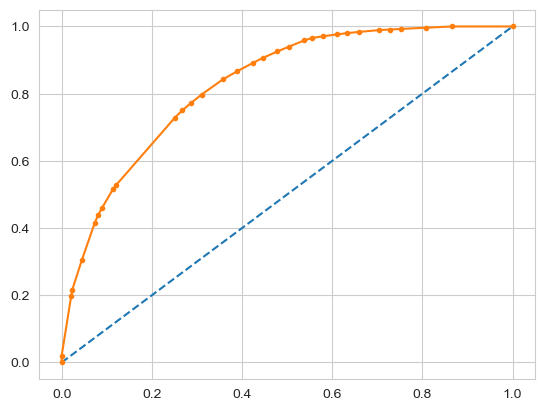

In [172]:
# AUC and ROC for the training data

# predict probabilities
probs = reg_dt_model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(train_labels, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(train_labels, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

AUC: 0.704


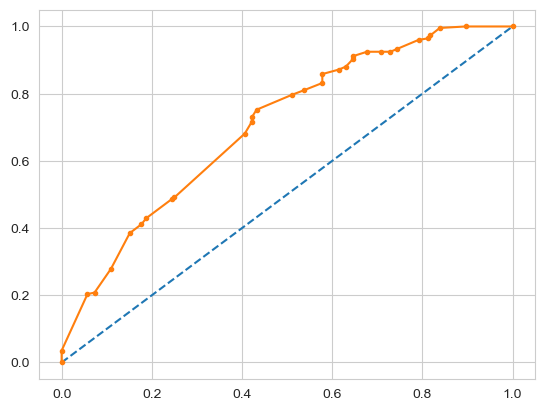

In [173]:
# AUC and ROC for the test data


# predict probabilities
probs = reg_dt_model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(test_labels, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(test_labels, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [174]:
from sklearn.metrics import classification_report,confusion_matrix

In [175]:
print(classification_report(train_labels, ytrain_predict))

              precision    recall  f1-score   support

           0       0.76      0.64      0.69       422
           1       0.76      0.84      0.80       553

    accuracy                           0.76       975
   macro avg       0.76      0.74      0.75       975
weighted avg       0.76      0.76      0.75       975



In [176]:
print(classification_report(test_labels, ytest_predict))

              precision    recall  f1-score   support

           0       0.67      0.49      0.57       192
           1       0.65      0.80      0.71       226

    accuracy                           0.66       418
   macro avg       0.66      0.64      0.64       418
weighted avg       0.66      0.66      0.65       418



In [177]:
confusion_matrix(train_labels, ytrain_predict)

array([[271, 151],
       [ 87, 466]], dtype=int64)

In [178]:
confusion_matrix(test_labels, ytest_predict)

array([[ 94,  98],
       [ 46, 180]], dtype=int64)

In [179]:
reg_dt_model.score(X_train,train_labels)

0.7558974358974359

In [180]:
reg_dt_model.score(X_test,test_labels)

0.6555023923444976